# Face Generation

In this project, you'll define and train a Generative Adverserial network of your own creation on a dataset of faces. Your goal is to get a generator network to generate *new* images of faces that look as realistic as possible!

The project will be broken down into a series of tasks from **defining new architectures training adversarial networks**. At the end of the notebook, you'll be able to visualize the results of your trained Generator to see how it performs; your generated samples should look like fairly realistic faces with small amounts of noise.

### Get the Data

You'll be using the [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) to train your adversarial networks.

This dataset has higher resolution images than datasets you have previously worked with (like MNIST or SVHN) you've been working with, and so, you should prepare to define deeper networks and train them for a longer time to get good results. It is suggested that you utilize a GPU for training.

### Pre-processed Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. Some sample data is show below.

<img src='assets/processed_face_data.png' width=60% />

> If you are working locally, you can download this data [by clicking here](https://s3.amazonaws.com/video.udacity-data.com/topher/2018/November/5be7eb6f_processed-celeba-small/processed-celeba-small.zip)

This is a zip file that you'll need to extract in the home directory of this notebook for further loading and processing. After extracting the data, you should be left with a directory of data `processed-celeba-small/`.

In [ ]:
# run this once to unzip the file
!unzip processed-celeba-small.zip

In [1]:
from glob import glob
from typing import Tuple, Callable, Dict

import matplotlib.pyplot as plt
import numpy as np
import torch
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchvision.transforms import Compose, ToTensor
from torchvision.transforms import (
    Compose,
    ToTensor,
    Normalize,
    Resize
)
from typing import Tuple, Callable
import tests

In [2]:
data_dir = 'processed_celeba_small/celeba/'

## Data pipeline

The [CelebA](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations. Since you're going to be generating faces, you won't need the annotations, you'll only need the images. Note that these are color images with [3 color channels (RGB)](https://en.wikipedia.org/wiki/Channel_(digital_image)#RGB_Images) each.

### Pre-process and Load the Data

Since the project's main focus is on building the GANs, we've done *some* of the pre-processing for you. Each of the CelebA images has been cropped to remove parts of the image that don't include a face, then resized down to 64x64x3 NumPy images. This *pre-processed* dataset is a smaller subset of the very large CelebA dataset and contains roughly 30,000 images. 

Your first task consists in building the dataloader. To do so, you need to do the following:
* implement the get_transforms function
* create a custom Dataset class that reads the CelebA data

### Exercise: implement the get_transforms function

The `get_transforms` function should output a [`torchvision.transforms.Compose`](https://pytorch.org/vision/stable/generated/torchvision.transforms.Compose.html#torchvision.transforms.Compose) of different transformations. You have two constraints:
* the function takes a tuple of size as input and should **resize the images** to the input size
* the output images should have values **ranging from -1 to 1**

In [3]:
# def get_transforms(size: Tuple[int, int]) -> Callable:
#     """ Transforms to apply to the image."""
#     # TODO: edit this function by appening transforms to the below list
#     transforms = [ToTensor()]
#     
#     return Compose(transforms)

def get_transforms(size: Tuple[int, int]) -> Callable:
    """
    Transforms to apply to the image.
    Args:
        size: Target size of the images
    Returns:
        Composition of transforms
    """
    transforms = [
        # Resize images to the specified size
        Resize(size),
        # Convert to tensor
        ToTensor(),
        # Normalize to range [-1, 1] as per GAN requirements
        Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ]
    return Compose(transforms)

### Exercise: implement the DatasetDirectory class


The `DatasetDirectory` class is a torch Dataset that reads from the above data directory. The `__getitem__` method should output a transformed tensor and the `__len__` method should output the number of files in our dataset. You can look at [this custom dataset](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html#creating-a-custom-dataset-for-your-files) for ideas. 

In [20]:
# class DatasetDirectory(Dataset):
#     """
#     A custom dataset class that loads images from folder.
#     args:
#     - directory: location of the images
#     - transform: transform function to apply to the images
#     - extension: file format
#     """
#     def __init__(self, 
#                  directory: str, 
#                  transforms: Callable = None, 
#                  extension: str = '.jpg'):
#         # TODO: implement the init method
# 
#     def __len__(self) -> int:
#         """ returns the number of items in the dataset """
#         # TODO: return the number of elements in the dataset
#         return 
# 
#     def __getitem__(self, index: int) -> torch.Tensor:
#         """ load an image and apply transformation """
#         # TODO: return the index-element of the dataset
#         return 
import os 

from PIL import Image, UnidentifiedImageError
import torch
from torch.utils.data import Dataset
import os
from torchvision import transforms
from typing import Callable

class DatasetDirectory(Dataset):
    def __init__(self, directory: str, transforms: Callable = None, extension: str = '.jpg'):
        """Initialize dataset with directory of images."""
        self.directory = directory
        self.image_files = sorted([
            os.path.join(directory, f) 
            for f in os.listdir(directory) 
            if f.endswith(extension)
        ])
        
        # Default transform if none provided
        self.transforms = transforms if transforms else get_transforms((64, 64))

    def __len__(self) -> int:
        return len(self.image_files)

    def __getitem__(self, index: int) -> torch.Tensor:
        """Get a single image."""
        # Get image path
        image_path = self.image_files[index]
        
        # Load and convert image to RGB
        image = Image.open(image_path).convert('RGB')
        
        # Apply transforms
        if self.transforms:
            image = self.transforms(image)
            
        return image

# def get_transforms(size: Tuple[int, int]) -> Callable:
#     """
#     Create transform pipeline.
#     Size should be (64, 64) for this project.
#     """
#     return transforms.Compose([
#         transforms.Resize(size),
#         transforms.ToTensor(),
#         transforms.Normalize(mean=[0.5, 0.5, 0.5], 
#                            std=[0.5, 0.5, 0.5])  # This scales to [-1, 1]
#     ])

In [6]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your dataset implementation
dataset = DatasetDirectory(data_dir, get_transforms((64, 64)))
tests.check_dataset_outputs(dataset)

Congrats, your dataset implementation passed all the tests


The functions below will help you visualize images from the dataset.

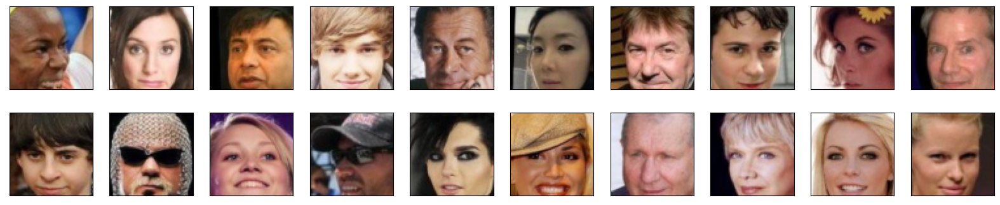

In [7]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def denormalize(images):
    """Transform images from [-1.0, 1.0] to [0, 255] and cast them to uint8."""
    return ((images + 1.) / 2. * 255).astype(np.uint8)

# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(20, 4))
plot_size=20
for idx in np.arange(plot_size):
    ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
    img = dataset[idx].numpy()
    img = np.transpose(img, (1, 2, 0))
    img = denormalize(img)
    ax.imshow(img)

## Model implementation

As you know, a GAN is comprised of two adversarial networks, a discriminator and a generator. Now that we have a working data pipeline, we need to implement the discriminator and the generator. 

Feel free to implement any additional class or function.

### Exercise: Create the discriminator

The discriminator's job is to score real and fake images. You have two constraints here:
* the discriminator takes as input a **batch of 64x64x3 images**
* the output should be a single value (=score)

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips
* To scale down from the input image, you can either use `Conv2d` layers with the correct hyperparameters or Pooling layers.
* If you plan on using gradient penalty, do not use Batch Normalization layers in the discriminator.

In [8]:
from torch.nn import Module
import torch
import torch.nn as nn


In [9]:
# class Discriminator(Module):
#     def __init__(self):
#         super(Discriminator, self).__init__()
#         # TODO: instantiate the different layers
        
#     def forward(self, x: torch.Tensor) -> torch.Tensor:
#         # TODO: implement the forward method
#         return x 


class Discriminator(Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        # DCGAN-style discriminator
        self.main = nn.Sequential(
            # Input: 3x64x64
            nn.Conv2d(3, 64, 4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 64x32x32
            nn.Conv2d(64, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 128x16x16
            nn.Conv2d(128, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 256x8x8
            nn.Conv2d(256, 512, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
            
            # 512x4x4 -> 1x1x1x1
            nn.Conv2d(512, 1, 4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        )
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.main(x).view(-1, 1, 1, 1)


In [10]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to check your discriminator implementation
discriminator = Discriminator()
tests.check_discriminator(discriminator)

Congrats, your discriminator implementation passed all the tests


### Exercise: create the generator

The generator's job creates the "fake images" and learns the dataset distribution. You have three constraints here:
* the generator takes as input a vector of dimension `[batch_size, latent_dimension, 1, 1]`
* the generator must outputs **64x64x3 images**

Feel free to get inspiration from the different architectures we talked about in the course, such as DCGAN, WGAN-GP or DRAGAN.

#### Some tips:
* to scale up from the latent vector input, you can use `ConvTranspose2d` layers
* as often with Gan, **Batch Normalization** helps with training

In [11]:
# class Generator(Module):
#     def __init__(self, latent_dim: int):
#         super(Generator, self).__init__()
#         # TODO: instantiate the different layers

#     def forward(self, x: torch.Tensor) -> torch.Tensor:
#         # TODO: implement the forward method
#         return x


class Generator(Module):
    def __init__(self, latent_dim: int):
        super(Generator, self).__init__()
        
        self.main = nn.Sequential(
            # Input: latent_dim x 1 x 1
            nn.ConvTranspose2d(latent_dim, 512, 4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            # 512 x 4 x 4
            nn.ConvTranspose2d(512, 256, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),
            
            # 256 x 8 x 8
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(True),
            
            # 128 x 16 x 16
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            
            # 64 x 32 x 32
            nn.ConvTranspose2d(64, 3, 4, stride=2, padding=1, bias=False),
            nn.Tanh()
            # Output: 3 x 64 x 64
        )
        
    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.main(x)

In [12]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
# run this cell to verify your generator implementation
latent_dim = 128
generator = Generator(latent_dim)
tests.check_generator(generator, latent_dim)

Congrats, your generator implementation passed all the tests


## Optimizer

In the following section, we create the optimizers for the generator and discriminator. You may want to experiment with different optimizers, learning rates and other hyperparameters as they tend to impact the output quality.

### Exercise: implement the optimizers

In [13]:
import torch.optim as optim


# def create_optimizers(generator: Module, discriminator: Module):
#     """ This function should return the optimizers of the generator and the discriminator """
#     # TODO: implement the generator and discriminator optimizers
#     g_optimizer = 
#     d_optimizer =
#     return g_optimizer, d_optimizer


def create_optimizers(generator: Module, discriminator: Module):
    """Creates optimizers for generator and discriminator"""
    g_optimizer = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    return g_optimizer, d_optimizer

## Losses implementation

In this section, we are going to implement the loss function for the generator and the discriminator. You can and should experiment with different loss function.

Some tips:
* You can choose the commonly used the binary cross entropy loss or select other losses we have discovered in the course, such as the Wasserstein distance.
* You may want to implement a gradient penalty function as discussed in the course. It is not required and the code will work whether you implement it or not.

### Exercise: implement the generator loss

The generator's goal is to get the discriminator to think its generated images (= "fake" images) are real.

In [14]:
# def generator_loss(fake_logits):
#     """ Generator loss, takes the fake scores as inputs. """
#     # TODO: implement the generator loss 
#     return loss


def generator_loss(fake_logits):
    """Generator loss"""
    criterion = nn.BCELoss()
    # Generate labels for fake images as if they were real
    labels = torch.ones_like(fake_logits)
    return criterion(fake_logits, labels)



### Exercise: implement the discriminator loss

We want the discriminator to give high scores to real images and low scores to fake ones and the discriminator loss should reflect that.

In [15]:
# def discriminator_loss(real_logits, fake_logits):
#     """ Discriminator loss, takes the fake and real logits as inputs. """
#     # TODO: implement the discriminator loss 
#     return loss

def discriminator_loss(real_logits, fake_logits):
    """Discriminator loss"""
    criterion = nn.BCELoss()
    # Real images should be labeled as 1
    real_labels = torch.ones_like(real_logits)
    # Fake images should be labeled as 0
    fake_labels = torch.zeros_like(fake_logits)
    
    real_loss = criterion(real_logits, real_labels)
    fake_loss = criterion(fake_logits, fake_labels)
    
    return real_loss + fake_loss

### Exercise (Optional): Implement the gradient Penalty

In the course, we discussed the importance of gradient penalty in training certain types of Gans. Implementing this function is not required and depends on some of the design decision you made (discriminator architecture, loss functions).

In [ ]:
def gradient_penalty(discriminator, real_samples, fake_samples):
    """ This function enforces """
    gp = 0
    # TODO (Optional): implement the gradient penalty
    return gp

## Training


Training will involve alternating between training the discriminator and the generator. You'll use your functions real_loss and fake_loss to help you calculate the discriminator losses.

* You should train the discriminator by alternating on real and fake images
* Then the generator, which tries to trick the discriminator and should have an opposing loss function

### Exercise: implement the generator step and the discriminator step functions

Each function should do the following:
* calculate the loss
* backpropagate the gradient
* perform one optimizer step

In [16]:
# def generator_step(batch_size: int, latent_dim: int) -> Dict:
#     """ One training step of the generator. """
#     # TODO: implement the generator step (foward pass, loss calculation and backward pass)
#     return {'loss': g_loss}


# def discriminator_step(batch_size: int, latent_dim: int, real_images: torch.Tensor) -> Dict:
#     """ One training step of the discriminator. """
#     # TODO: implement the discriminator step (foward pass, loss calculation and backward pass)
#     return {'loss': d_loss, 'gp': gp}


def generator_step(generator, discriminator, g_optimizer, batch_size, latent_dim, device):
    """One training step for generator"""
    g_optimizer.zero_grad()
    
    # Generate fake images
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    fake_images = generator(noise)
    
    # Get discriminator output on fake images
    fake_logits = discriminator(fake_images)
    
    # Calculate generator loss
    g_loss = generator_loss(fake_logits)
    
    # Backpropagate and update
    g_loss.backward()
    g_optimizer.step()
    
    return {'loss': g_loss}

def discriminator_step(generator, discriminator, d_optimizer, batch_size, latent_dim, real_images, device):
    """One training step for discriminator"""
    d_optimizer.zero_grad()
    
    # Get discriminator output on real images
    real_logits = discriminator(real_images)
    
    # Generate and get output on fake images
    noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)
    with torch.no_grad():
        fake_images = generator(noise)
    fake_logits = discriminator(fake_images)
    
    # Calculate discriminator loss
    d_loss = discriminator_loss(real_logits, fake_logits)
    
    # Backpropagate and update
    d_loss.backward()
    d_optimizer.step()
    
    return {'loss': d_loss}

### Main training loop

You don't have to implement anything here but you can experiment with different hyperparameters.

In [ ]:
from datetime import datetime

In [27]:
# you can experiment with different dimensions of latent spaces
latent_dim = 128

# update to cpu if you do not have access to a gpu
# device = 'cuda'

# Device selection
if torch.cuda.is_available():
    device = 'cuda'  # For machines with NVIDIA GPUs
elif torch.backends.mps.is_available():
    device = 'mps'  # For Apple M1/M2 (Metal Performance Shaders)
else:
    device = 'cpu'  # Fallback to CPU if no compatible hardware acceleration is available

print(f"Using device: {device}")


# number of epochs to train your model
n_epochs = 50

# number of images in each batch
batch_size = 64

Using device: mps


In [28]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
print_every = 50

# Create optimizers for the discriminator D and generator G
generator = Generator(latent_dim).to(device)
discriminator = Discriminator().to(device)
g_optimizer, d_optimizer = create_optimizers(generator, discriminator)

dataloader = DataLoader(dataset, 
                        batch_size=64, 
                        shuffle=True, 
                        num_workers=0, 
                        drop_last=True,
                        pin_memory=False)

In [29]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""

def display(fixed_latent_vector: torch.Tensor):
    """ helper function to display images during training """
    fig = plt.figure(figsize=(14, 4))
    plot_size = 16
    for idx in np.arange(plot_size):
        ax = fig.add_subplot(2, int(plot_size/2), idx+1, xticks=[], yticks=[])
        img = fixed_latent_vector[idx, ...].detach().cpu().numpy()
        img = np.transpose(img, (1, 2, 0))
        img = denormalize(img)
        ax.imshow(img)
    plt.show()

### Exercise: implement the training strategy

You should experiment with different training strategies. For example:

* train the generator more often than the discriminator. 
* added noise to the input image
* use label smoothing

Implement with your training strategy below.

Starting Epoch [1/50]...
2024-11-01 11:44:58 | Epoch [1/50] | Batch 0/509 | d_loss: 1.4464 | g_loss: 2.4583
2024-11-01 11:45:01 | Epoch [1/50] | Batch 50/509 | d_loss: 0.0295 | g_loss: 15.2825
2024-11-01 11:45:04 | Epoch [1/50] | Batch 100/509 | d_loss: 1.0790 | g_loss: 3.1883
2024-11-01 11:45:08 | Epoch [1/50] | Batch 150/509 | d_loss: 0.3561 | g_loss: 4.9720
2024-11-01 11:45:12 | Epoch [1/50] | Batch 200/509 | d_loss: 0.6866 | g_loss: 4.3584
2024-11-01 11:45:16 | Epoch [1/50] | Batch 250/509 | d_loss: 0.3226 | g_loss: 3.0058
2024-11-01 11:45:20 | Epoch [1/50] | Batch 300/509 | d_loss: 0.2370 | g_loss: 5.2400
2024-11-01 11:45:24 | Epoch [1/50] | Batch 350/509 | d_loss: 0.7284 | g_loss: 1.6076
2024-11-01 11:45:27 | Epoch [1/50] | Batch 400/509 | d_loss: 0.6778 | g_loss: 5.3562
2024-11-01 11:45:31 | Epoch [1/50] | Batch 450/509 | d_loss: 0.2169 | g_loss: 4.5444
2024-11-01 11:45:35 | Epoch [1/50] | Batch 500/509 | d_loss: 0.4043 | g_loss: 6.3636
End of Epoch [1/50]. Generating sample ima

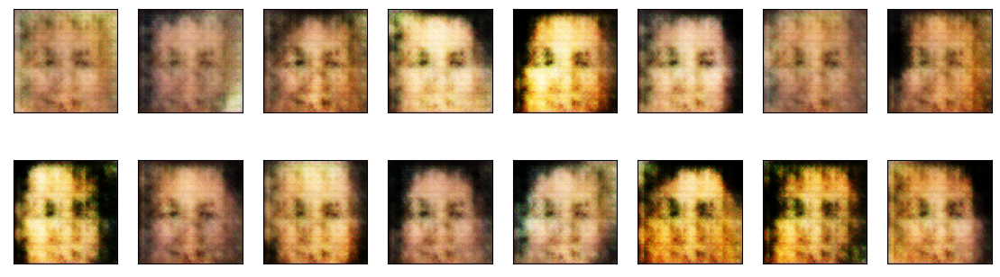

Starting Epoch [2/50]...
2024-11-01 11:45:37 | Epoch [2/50] | Batch 0/509 | d_loss: 1.3904 | g_loss: 1.8488
2024-11-01 11:45:41 | Epoch [2/50] | Batch 50/509 | d_loss: 0.5880 | g_loss: 5.5822
2024-11-01 11:45:45 | Epoch [2/50] | Batch 100/509 | d_loss: 0.5577 | g_loss: 3.6650
2024-11-01 11:45:49 | Epoch [2/50] | Batch 150/509 | d_loss: 0.8481 | g_loss: 7.6556
2024-11-01 11:45:53 | Epoch [2/50] | Batch 200/509 | d_loss: 0.5461 | g_loss: 4.7046
2024-11-01 11:45:57 | Epoch [2/50] | Batch 250/509 | d_loss: 0.4973 | g_loss: 6.6014
2024-11-01 11:46:02 | Epoch [2/50] | Batch 300/509 | d_loss: 0.2264 | g_loss: 4.0331
2024-11-01 11:46:06 | Epoch [2/50] | Batch 350/509 | d_loss: 0.5488 | g_loss: 3.3349
2024-11-01 11:46:10 | Epoch [2/50] | Batch 400/509 | d_loss: 0.6558 | g_loss: 5.9226
2024-11-01 11:46:15 | Epoch [2/50] | Batch 450/509 | d_loss: 0.8115 | g_loss: 6.6151
2024-11-01 11:46:19 | Epoch [2/50] | Batch 500/509 | d_loss: 0.6895 | g_loss: 5.0709
End of Epoch [2/50]. Generating sample imag

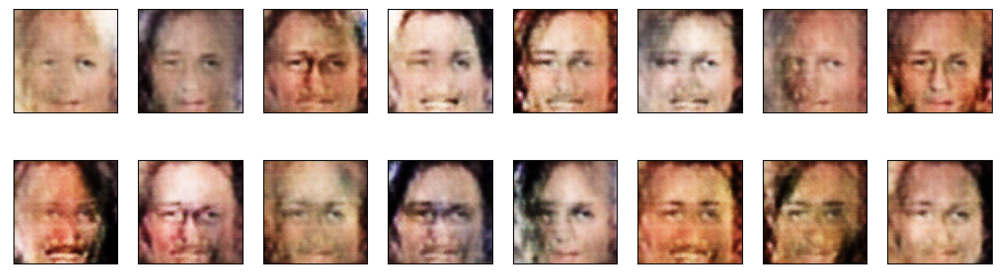

Starting Epoch [3/50]...
2024-11-01 11:46:20 | Epoch [3/50] | Batch 0/509 | d_loss: 0.3335 | g_loss: 3.4809
2024-11-01 11:46:25 | Epoch [3/50] | Batch 50/509 | d_loss: 0.4160 | g_loss: 3.2796
2024-11-01 11:46:29 | Epoch [3/50] | Batch 100/509 | d_loss: 0.1281 | g_loss: 3.0068
2024-11-01 11:46:33 | Epoch [3/50] | Batch 150/509 | d_loss: 0.4097 | g_loss: 4.0118
2024-11-01 11:46:38 | Epoch [3/50] | Batch 200/509 | d_loss: 0.6244 | g_loss: 5.8703
2024-11-01 11:46:42 | Epoch [3/50] | Batch 250/509 | d_loss: 0.3956 | g_loss: 4.5378
2024-11-01 11:46:47 | Epoch [3/50] | Batch 300/509 | d_loss: 0.2808 | g_loss: 5.1321
2024-11-01 11:46:52 | Epoch [3/50] | Batch 350/509 | d_loss: 0.3832 | g_loss: 3.2822
2024-11-01 11:46:56 | Epoch [3/50] | Batch 400/509 | d_loss: 0.3284 | g_loss: 2.8425
2024-11-01 11:47:01 | Epoch [3/50] | Batch 450/509 | d_loss: 0.3259 | g_loss: 3.3395
2024-11-01 11:47:05 | Epoch [3/50] | Batch 500/509 | d_loss: 0.5178 | g_loss: 2.5371
End of Epoch [3/50]. Generating sample imag

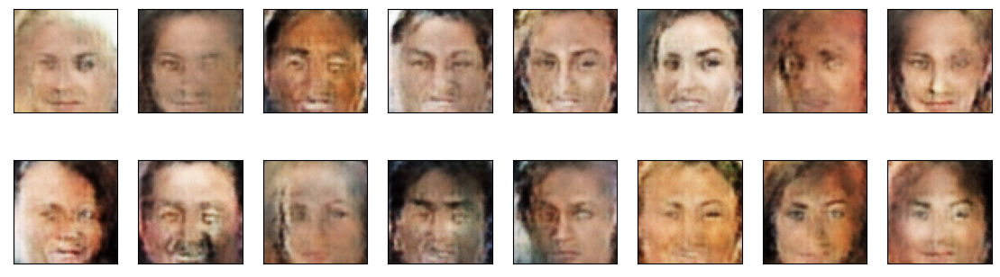

Starting Epoch [4/50]...
2024-11-01 11:47:07 | Epoch [4/50] | Batch 0/509 | d_loss: 0.2733 | g_loss: 4.3038
2024-11-01 11:47:11 | Epoch [4/50] | Batch 50/509 | d_loss: 0.1291 | g_loss: 3.9283
2024-11-01 11:47:16 | Epoch [4/50] | Batch 100/509 | d_loss: 0.2155 | g_loss: 4.7498
2024-11-01 11:47:21 | Epoch [4/50] | Batch 150/509 | d_loss: 0.2523 | g_loss: 3.5490
2024-11-01 11:47:25 | Epoch [4/50] | Batch 200/509 | d_loss: 0.4402 | g_loss: 3.3362
2024-11-01 11:47:30 | Epoch [4/50] | Batch 250/509 | d_loss: 0.1559 | g_loss: 3.8900
2024-11-01 11:47:35 | Epoch [4/50] | Batch 300/509 | d_loss: 0.3886 | g_loss: 4.2325
2024-11-01 11:47:40 | Epoch [4/50] | Batch 350/509 | d_loss: 0.4187 | g_loss: 3.2477
2024-11-01 11:47:45 | Epoch [4/50] | Batch 400/509 | d_loss: 0.2226 | g_loss: 3.6272
2024-11-01 11:47:50 | Epoch [4/50] | Batch 450/509 | d_loss: 0.3515 | g_loss: 4.0735
2024-11-01 11:47:55 | Epoch [4/50] | Batch 500/509 | d_loss: 0.4767 | g_loss: 3.9831
End of Epoch [4/50]. Generating sample imag

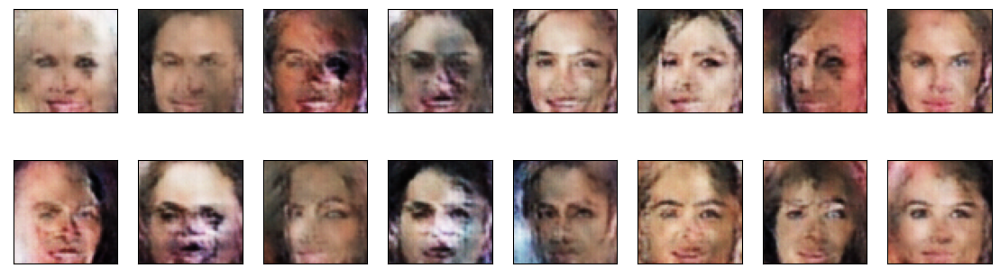

Starting Epoch [5/50]...
2024-11-01 11:47:56 | Epoch [5/50] | Batch 0/509 | d_loss: 0.5411 | g_loss: 5.5457
2024-11-01 11:48:01 | Epoch [5/50] | Batch 50/509 | d_loss: 0.4876 | g_loss: 5.0960
2024-11-01 11:48:05 | Epoch [5/50] | Batch 100/509 | d_loss: 0.2436 | g_loss: 4.4140
2024-11-01 11:48:10 | Epoch [5/50] | Batch 150/509 | d_loss: 0.1970 | g_loss: 5.1068
2024-11-01 11:48:15 | Epoch [5/50] | Batch 200/509 | d_loss: 1.1064 | g_loss: 7.9273
2024-11-01 11:48:20 | Epoch [5/50] | Batch 250/509 | d_loss: 0.1513 | g_loss: 3.4021
2024-11-01 11:48:24 | Epoch [5/50] | Batch 300/509 | d_loss: 0.2688 | g_loss: 4.3918
2024-11-01 11:48:29 | Epoch [5/50] | Batch 350/509 | d_loss: 1.9667 | g_loss: 1.4124
2024-11-01 11:48:34 | Epoch [5/50] | Batch 400/509 | d_loss: 0.2424 | g_loss: 3.8419
2024-11-01 11:48:39 | Epoch [5/50] | Batch 450/509 | d_loss: 0.2119 | g_loss: 4.2624
2024-11-01 11:48:43 | Epoch [5/50] | Batch 500/509 | d_loss: 0.1730 | g_loss: 6.4502
End of Epoch [5/50]. Generating sample imag

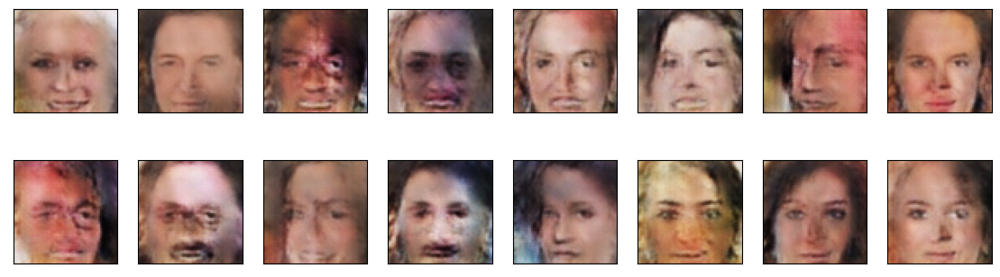

Starting Epoch [6/50]...
2024-11-01 11:48:45 | Epoch [6/50] | Batch 0/509 | d_loss: 0.7976 | g_loss: 6.8078
2024-11-01 11:48:50 | Epoch [6/50] | Batch 50/509 | d_loss: 0.0903 | g_loss: 2.2712
2024-11-01 11:48:54 | Epoch [6/50] | Batch 100/509 | d_loss: 0.6416 | g_loss: 5.3426
2024-11-01 11:48:59 | Epoch [6/50] | Batch 150/509 | d_loss: 0.1864 | g_loss: 4.4101
2024-11-01 11:49:03 | Epoch [6/50] | Batch 200/509 | d_loss: 0.2005 | g_loss: 3.9461
2024-11-01 11:49:08 | Epoch [6/50] | Batch 250/509 | d_loss: 0.2935 | g_loss: 4.8032
2024-11-01 11:49:13 | Epoch [6/50] | Batch 300/509 | d_loss: 0.3157 | g_loss: 5.1149
2024-11-01 11:49:17 | Epoch [6/50] | Batch 350/509 | d_loss: 0.1322 | g_loss: 4.3031
2024-11-01 11:49:22 | Epoch [6/50] | Batch 400/509 | d_loss: 0.3258 | g_loss: 3.4631
2024-11-01 11:49:27 | Epoch [6/50] | Batch 450/509 | d_loss: 0.3352 | g_loss: 5.5325
2024-11-01 11:49:31 | Epoch [6/50] | Batch 500/509 | d_loss: 0.6777 | g_loss: 8.2694
End of Epoch [6/50]. Generating sample imag

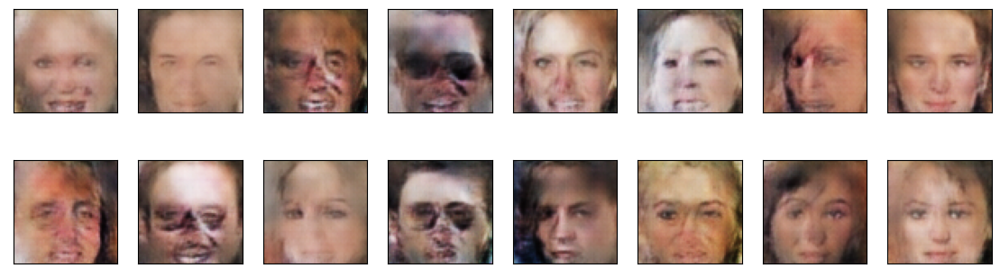

Starting Epoch [7/50]...
2024-11-01 11:49:32 | Epoch [7/50] | Batch 0/509 | d_loss: 0.1451 | g_loss: 3.8278
2024-11-01 11:49:37 | Epoch [7/50] | Batch 50/509 | d_loss: 0.4760 | g_loss: 6.2818
2024-11-01 11:49:41 | Epoch [7/50] | Batch 100/509 | d_loss: 0.3039 | g_loss: 4.1372
2024-11-01 11:49:46 | Epoch [7/50] | Batch 150/509 | d_loss: 2.9332 | g_loss: 4.5495
2024-11-01 11:49:51 | Epoch [7/50] | Batch 200/509 | d_loss: 0.1224 | g_loss: 5.0062
2024-11-01 11:49:55 | Epoch [7/50] | Batch 250/509 | d_loss: 0.1615 | g_loss: 4.1284
2024-11-01 11:49:59 | Epoch [7/50] | Batch 300/509 | d_loss: 0.1683 | g_loss: 5.5422
2024-11-01 11:50:04 | Epoch [7/50] | Batch 350/509 | d_loss: 0.3782 | g_loss: 4.5341
2024-11-01 11:50:08 | Epoch [7/50] | Batch 400/509 | d_loss: 0.2561 | g_loss: 2.9430
2024-11-01 11:50:13 | Epoch [7/50] | Batch 450/509 | d_loss: 0.1705 | g_loss: 4.7362
2024-11-01 11:50:17 | Epoch [7/50] | Batch 500/509 | d_loss: 0.2721 | g_loss: 5.1826
End of Epoch [7/50]. Generating sample imag

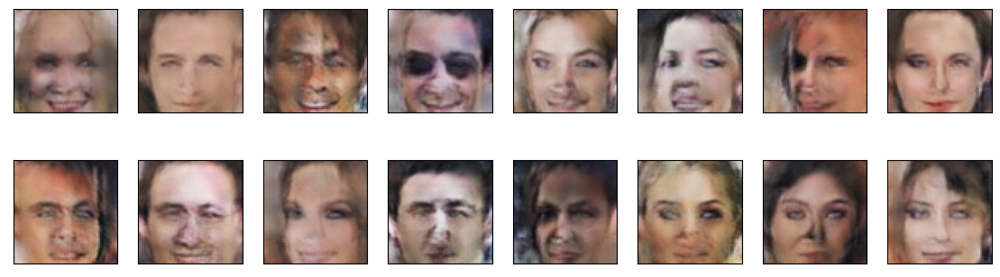

Starting Epoch [8/50]...
2024-11-01 11:50:19 | Epoch [8/50] | Batch 0/509 | d_loss: 0.1533 | g_loss: 4.5909
2024-11-01 11:50:23 | Epoch [8/50] | Batch 50/509 | d_loss: 0.4791 | g_loss: 7.1004
2024-11-01 11:50:27 | Epoch [8/50] | Batch 100/509 | d_loss: 0.2884 | g_loss: 4.9259
2024-11-01 11:50:32 | Epoch [8/50] | Batch 150/509 | d_loss: 0.2644 | g_loss: 5.5253
2024-11-01 11:50:36 | Epoch [8/50] | Batch 200/509 | d_loss: 0.0713 | g_loss: 3.9260
2024-11-01 11:50:41 | Epoch [8/50] | Batch 250/509 | d_loss: 0.1991 | g_loss: 3.9902
2024-11-01 11:50:45 | Epoch [8/50] | Batch 300/509 | d_loss: 0.1551 | g_loss: 4.5352
2024-11-01 11:50:49 | Epoch [8/50] | Batch 350/509 | d_loss: 0.1426 | g_loss: 4.4429
2024-11-01 11:50:54 | Epoch [8/50] | Batch 400/509 | d_loss: 0.5455 | g_loss: 4.8652
2024-11-01 11:50:58 | Epoch [8/50] | Batch 450/509 | d_loss: 0.0548 | g_loss: 3.9117
2024-11-01 11:51:03 | Epoch [8/50] | Batch 500/509 | d_loss: 0.0579 | g_loss: 5.3862
End of Epoch [8/50]. Generating sample imag

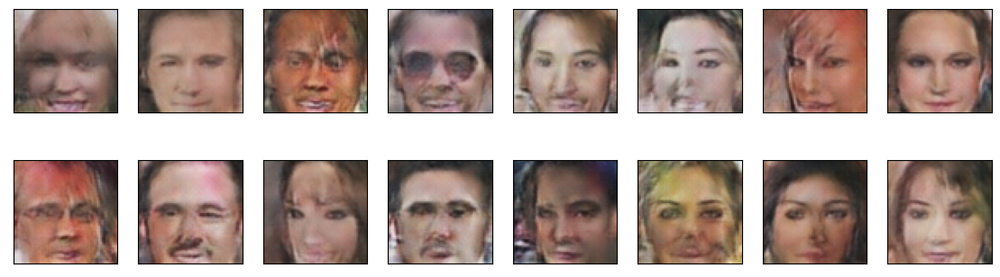

Starting Epoch [9/50]...
2024-11-01 11:51:04 | Epoch [9/50] | Batch 0/509 | d_loss: 0.2092 | g_loss: 6.6288
2024-11-01 11:51:08 | Epoch [9/50] | Batch 50/509 | d_loss: 0.2777 | g_loss: 6.4385
2024-11-01 11:51:13 | Epoch [9/50] | Batch 100/509 | d_loss: 0.1304 | g_loss: 2.9828
2024-11-01 11:51:17 | Epoch [9/50] | Batch 150/509 | d_loss: 0.2391 | g_loss: 6.4119
2024-11-01 11:51:21 | Epoch [9/50] | Batch 200/509 | d_loss: 1.6162 | g_loss: 10.5974
2024-11-01 11:51:26 | Epoch [9/50] | Batch 250/509 | d_loss: 0.0914 | g_loss: 3.3877
2024-11-01 11:51:30 | Epoch [9/50] | Batch 300/509 | d_loss: 0.4122 | g_loss: 6.6906
2024-11-01 11:51:35 | Epoch [9/50] | Batch 350/509 | d_loss: 0.1962 | g_loss: 5.0364
2024-11-01 11:51:39 | Epoch [9/50] | Batch 400/509 | d_loss: 0.1257 | g_loss: 4.3909
2024-11-01 11:51:43 | Epoch [9/50] | Batch 450/509 | d_loss: 0.1727 | g_loss: 3.5468
2024-11-01 11:51:48 | Epoch [9/50] | Batch 500/509 | d_loss: 1.0041 | g_loss: 9.3708
End of Epoch [9/50]. Generating sample ima

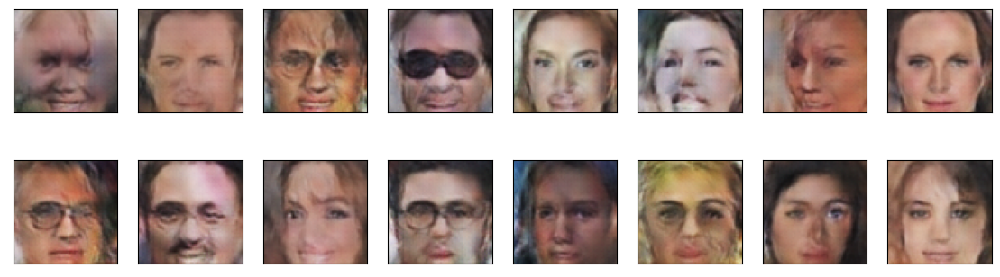

Starting Epoch [10/50]...
2024-11-01 11:51:49 | Epoch [10/50] | Batch 0/509 | d_loss: 0.0722 | g_loss: 5.1815
2024-11-01 11:51:53 | Epoch [10/50] | Batch 50/509 | d_loss: 0.0946 | g_loss: 1.8225
2024-11-01 11:51:57 | Epoch [10/50] | Batch 100/509 | d_loss: 0.1619 | g_loss: 5.9988
2024-11-01 11:52:02 | Epoch [10/50] | Batch 150/509 | d_loss: 0.0858 | g_loss: 4.9095
2024-11-01 11:52:06 | Epoch [10/50] | Batch 200/509 | d_loss: 0.3512 | g_loss: 5.4203
2024-11-01 11:52:11 | Epoch [10/50] | Batch 250/509 | d_loss: 0.0630 | g_loss: 4.1486
2024-11-01 11:52:15 | Epoch [10/50] | Batch 300/509 | d_loss: 1.5620 | g_loss: 6.8468
2024-11-01 11:52:19 | Epoch [10/50] | Batch 350/509 | d_loss: 0.0653 | g_loss: 4.7392
2024-11-01 11:52:24 | Epoch [10/50] | Batch 400/509 | d_loss: 0.0104 | g_loss: 10.4301
2024-11-01 11:52:28 | Epoch [10/50] | Batch 450/509 | d_loss: 0.0593 | g_loss: 6.0166
2024-11-01 11:52:33 | Epoch [10/50] | Batch 500/509 | d_loss: 0.3393 | g_loss: 4.9307
End of Epoch [10/50]. Generati

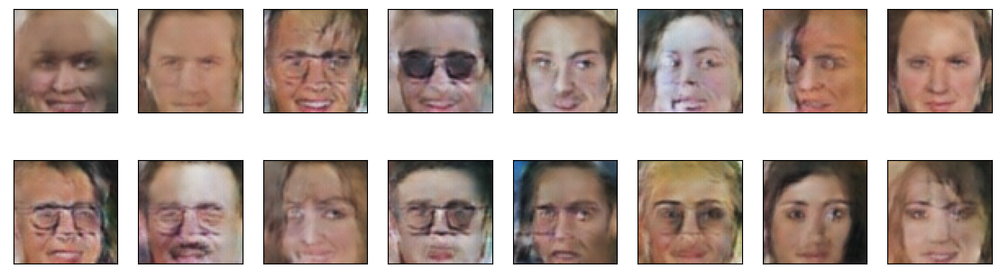

Starting Epoch [11/50]...
2024-11-01 11:52:34 | Epoch [11/50] | Batch 0/509 | d_loss: 0.0423 | g_loss: 4.3497
2024-11-01 11:52:38 | Epoch [11/50] | Batch 50/509 | d_loss: 0.9092 | g_loss: 7.0881
2024-11-01 11:52:43 | Epoch [11/50] | Batch 100/509 | d_loss: 0.5274 | g_loss: 7.2794
2024-11-01 11:52:47 | Epoch [11/50] | Batch 150/509 | d_loss: 0.6397 | g_loss: 7.1600
2024-11-01 11:52:52 | Epoch [11/50] | Batch 200/509 | d_loss: 0.1447 | g_loss: 10.5405
2024-11-01 11:52:56 | Epoch [11/50] | Batch 250/509 | d_loss: 0.0981 | g_loss: 3.8247
2024-11-01 11:53:00 | Epoch [11/50] | Batch 300/509 | d_loss: 0.1214 | g_loss: 3.6077
2024-11-01 11:53:05 | Epoch [11/50] | Batch 350/509 | d_loss: 0.0835 | g_loss: 8.4350
2024-11-01 11:53:09 | Epoch [11/50] | Batch 400/509 | d_loss: 0.2383 | g_loss: 6.5950
2024-11-01 11:53:14 | Epoch [11/50] | Batch 450/509 | d_loss: 0.0016 | g_loss: 9.1320
2024-11-01 11:53:18 | Epoch [11/50] | Batch 500/509 | d_loss: 0.0798 | g_loss: 4.7356
End of Epoch [11/50]. Generati

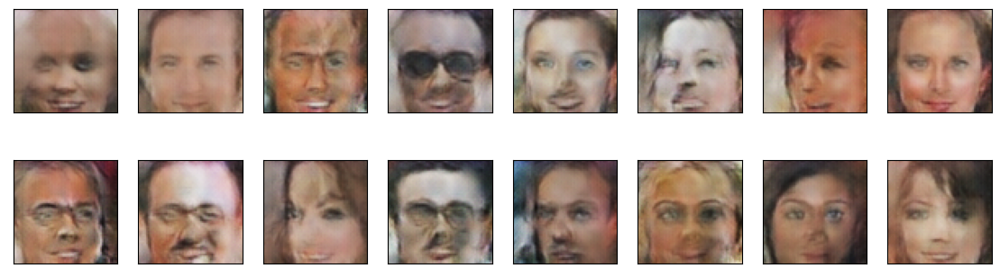

Starting Epoch [12/50]...
2024-11-01 11:53:19 | Epoch [12/50] | Batch 0/509 | d_loss: 1.4145 | g_loss: 11.4693
2024-11-01 11:53:24 | Epoch [12/50] | Batch 50/509 | d_loss: 0.5081 | g_loss: 6.1078
2024-11-01 11:53:28 | Epoch [12/50] | Batch 100/509 | d_loss: 0.0016 | g_loss: 9.7646
2024-11-01 11:53:33 | Epoch [12/50] | Batch 150/509 | d_loss: 0.1274 | g_loss: 5.2258
2024-11-01 11:53:37 | Epoch [12/50] | Batch 200/509 | d_loss: 0.0175 | g_loss: 7.0723
2024-11-01 11:53:42 | Epoch [12/50] | Batch 250/509 | d_loss: 0.0269 | g_loss: 6.1802
2024-11-01 11:53:46 | Epoch [12/50] | Batch 300/509 | d_loss: 0.1093 | g_loss: 3.5891
2024-11-01 11:53:50 | Epoch [12/50] | Batch 350/509 | d_loss: 2.0104 | g_loss: 2.9318
2024-11-01 11:53:55 | Epoch [12/50] | Batch 400/509 | d_loss: 0.1213 | g_loss: 5.2970
2024-11-01 11:53:59 | Epoch [12/50] | Batch 450/509 | d_loss: 0.0040 | g_loss: 8.7232
2024-11-01 11:54:04 | Epoch [12/50] | Batch 500/509 | d_loss: 0.0205 | g_loss: 7.5135
End of Epoch [12/50]. Generati

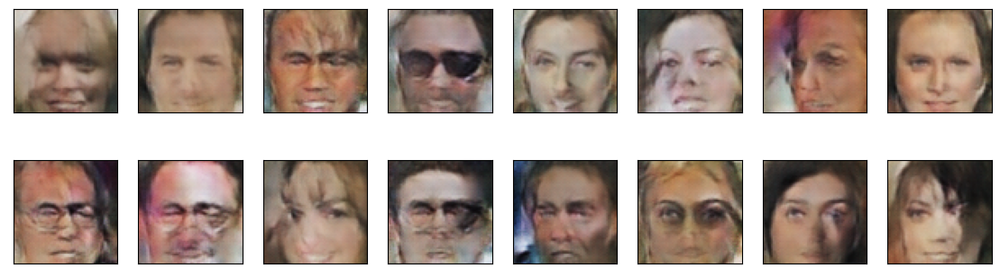

Starting Epoch [13/50]...
2024-11-01 11:54:05 | Epoch [13/50] | Batch 0/509 | d_loss: 0.0555 | g_loss: 11.0421
2024-11-01 11:54:09 | Epoch [13/50] | Batch 50/509 | d_loss: 0.0458 | g_loss: 4.2661
2024-11-01 11:54:14 | Epoch [13/50] | Batch 100/509 | d_loss: 0.0205 | g_loss: 6.4372
2024-11-01 11:54:18 | Epoch [13/50] | Batch 150/509 | d_loss: 2.7486 | g_loss: 9.7329
2024-11-01 11:54:23 | Epoch [13/50] | Batch 200/509 | d_loss: 0.0415 | g_loss: 4.9131
2024-11-01 11:54:27 | Epoch [13/50] | Batch 250/509 | d_loss: 0.2876 | g_loss: 5.1038
2024-11-01 11:54:31 | Epoch [13/50] | Batch 300/509 | d_loss: 0.0119 | g_loss: 5.4789
2024-11-01 11:54:36 | Epoch [13/50] | Batch 350/509 | d_loss: 0.0021 | g_loss: 13.7073
2024-11-01 11:54:40 | Epoch [13/50] | Batch 400/509 | d_loss: 1.0676 | g_loss: 8.6739
2024-11-01 11:54:45 | Epoch [13/50] | Batch 450/509 | d_loss: 0.0675 | g_loss: 2.1055
2024-11-01 11:54:49 | Epoch [13/50] | Batch 500/509 | d_loss: 0.9191 | g_loss: 10.6312
End of Epoch [13/50]. Genera

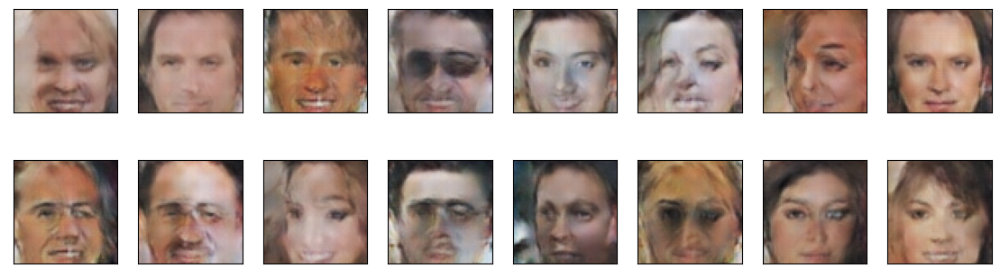

Starting Epoch [14/50]...
2024-11-01 11:54:50 | Epoch [14/50] | Batch 0/509 | d_loss: 0.6033 | g_loss: 7.6559
2024-11-01 11:54:55 | Epoch [14/50] | Batch 50/509 | d_loss: 0.0071 | g_loss: 9.8472
2024-11-01 11:54:59 | Epoch [14/50] | Batch 100/509 | d_loss: 0.0196 | g_loss: 9.5533
2024-11-01 11:55:03 | Epoch [14/50] | Batch 150/509 | d_loss: 0.0241 | g_loss: 7.6544
2024-11-01 11:55:08 | Epoch [14/50] | Batch 200/509 | d_loss: 0.3327 | g_loss: 3.8940
2024-11-01 11:55:12 | Epoch [14/50] | Batch 250/509 | d_loss: 0.2584 | g_loss: 5.6048
2024-11-01 11:55:16 | Epoch [14/50] | Batch 300/509 | d_loss: 0.0543 | g_loss: 9.3903
2024-11-01 11:55:21 | Epoch [14/50] | Batch 350/509 | d_loss: 0.0107 | g_loss: 12.8984
2024-11-01 11:55:25 | Epoch [14/50] | Batch 400/509 | d_loss: 0.2776 | g_loss: 5.7643
2024-11-01 11:55:30 | Epoch [14/50] | Batch 450/509 | d_loss: 0.0507 | g_loss: 7.3948
2024-11-01 11:55:34 | Epoch [14/50] | Batch 500/509 | d_loss: 0.0272 | g_loss: 8.0340
End of Epoch [14/50]. Generati

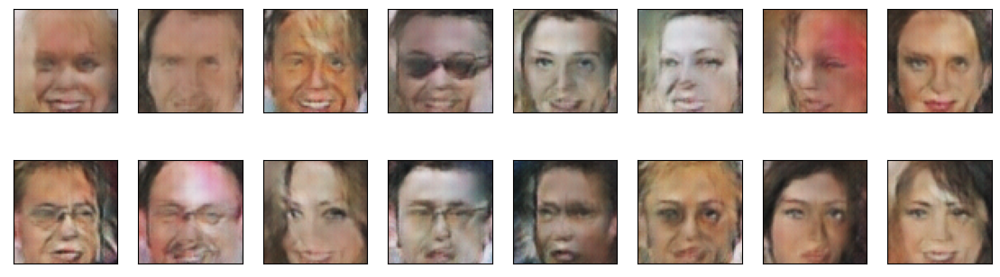

Starting Epoch [15/50]...
2024-11-01 11:55:35 | Epoch [15/50] | Batch 0/509 | d_loss: 0.1138 | g_loss: 11.3314
2024-11-01 11:55:39 | Epoch [15/50] | Batch 50/509 | d_loss: 0.0781 | g_loss: 5.3302
2024-11-01 11:55:44 | Epoch [15/50] | Batch 100/509 | d_loss: 0.0436 | g_loss: 2.8840
2024-11-01 11:55:48 | Epoch [15/50] | Batch 150/509 | d_loss: 0.0452 | g_loss: 8.2472
2024-11-01 11:55:53 | Epoch [15/50] | Batch 200/509 | d_loss: 0.0033 | g_loss: 11.9585
2024-11-01 11:55:57 | Epoch [15/50] | Batch 250/509 | d_loss: 0.0027 | g_loss: 8.3341
2024-11-01 11:56:02 | Epoch [15/50] | Batch 300/509 | d_loss: 0.0193 | g_loss: 11.6902
2024-11-01 11:56:06 | Epoch [15/50] | Batch 350/509 | d_loss: 0.0417 | g_loss: 6.3109
2024-11-01 11:56:10 | Epoch [15/50] | Batch 400/509 | d_loss: 0.0331 | g_loss: 6.0657
2024-11-01 11:56:15 | Epoch [15/50] | Batch 450/509 | d_loss: 6.4403 | g_loss: 6.9863
2024-11-01 11:56:19 | Epoch [15/50] | Batch 500/509 | d_loss: 0.0335 | g_loss: 7.2865
End of Epoch [15/50]. Genera

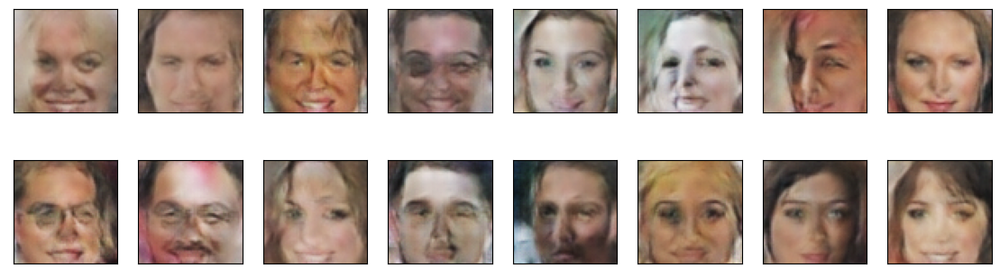

Starting Epoch [16/50]...
2024-11-01 11:56:20 | Epoch [16/50] | Batch 0/509 | d_loss: 0.4816 | g_loss: 5.9454
2024-11-01 11:56:25 | Epoch [16/50] | Batch 50/509 | d_loss: 0.0142 | g_loss: 5.8380
2024-11-01 11:56:29 | Epoch [16/50] | Batch 100/509 | d_loss: 0.0212 | g_loss: 4.5807
2024-11-01 11:56:33 | Epoch [16/50] | Batch 150/509 | d_loss: 0.0087 | g_loss: 7.4132
2024-11-01 11:56:38 | Epoch [16/50] | Batch 200/509 | d_loss: 4.0597 | g_loss: 8.8214
2024-11-01 11:56:42 | Epoch [16/50] | Batch 250/509 | d_loss: 0.0815 | g_loss: 4.6258
2024-11-01 11:56:47 | Epoch [16/50] | Batch 300/509 | d_loss: 0.0752 | g_loss: 4.4810
2024-11-01 11:56:51 | Epoch [16/50] | Batch 350/509 | d_loss: 0.0588 | g_loss: 7.1713
2024-11-01 11:56:55 | Epoch [16/50] | Batch 400/509 | d_loss: 0.0129 | g_loss: 4.6927
2024-11-01 11:57:00 | Epoch [16/50] | Batch 450/509 | d_loss: 0.0233 | g_loss: 4.5787
2024-11-01 11:57:04 | Epoch [16/50] | Batch 500/509 | d_loss: 0.0350 | g_loss: 3.9348
End of Epoch [16/50]. Generatin

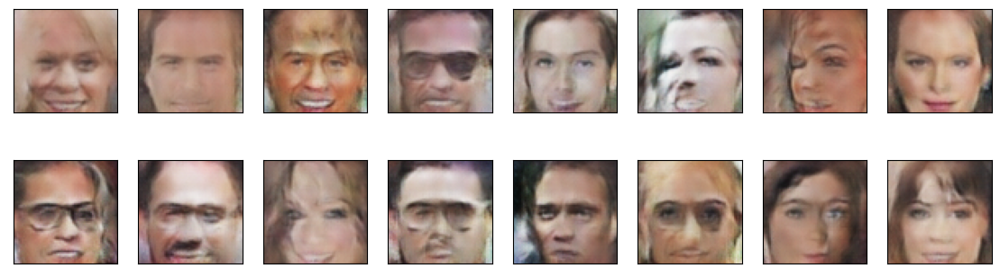

Starting Epoch [17/50]...
2024-11-01 11:57:05 | Epoch [17/50] | Batch 0/509 | d_loss: 0.1198 | g_loss: 5.2030
2024-11-01 11:57:09 | Epoch [17/50] | Batch 50/509 | d_loss: 1.2987 | g_loss: 11.2642
2024-11-01 11:57:14 | Epoch [17/50] | Batch 100/509 | d_loss: 0.0704 | g_loss: 4.2870
2024-11-01 11:57:18 | Epoch [17/50] | Batch 150/509 | d_loss: 0.0156 | g_loss: 7.3631
2024-11-01 11:57:23 | Epoch [17/50] | Batch 200/509 | d_loss: 0.2949 | g_loss: 5.7180
2024-11-01 11:57:27 | Epoch [17/50] | Batch 250/509 | d_loss: 4.9176 | g_loss: 6.6411
2024-11-01 11:57:32 | Epoch [17/50] | Batch 300/509 | d_loss: 0.1865 | g_loss: 4.6888
2024-11-01 11:57:36 | Epoch [17/50] | Batch 350/509 | d_loss: 0.0036 | g_loss: 8.3025
2024-11-01 11:57:40 | Epoch [17/50] | Batch 400/509 | d_loss: 0.6561 | g_loss: 3.8918
2024-11-01 11:57:45 | Epoch [17/50] | Batch 450/509 | d_loss: 0.0217 | g_loss: 7.6195
2024-11-01 11:57:49 | Epoch [17/50] | Batch 500/509 | d_loss: 0.1493 | g_loss: 3.2167
End of Epoch [17/50]. Generati

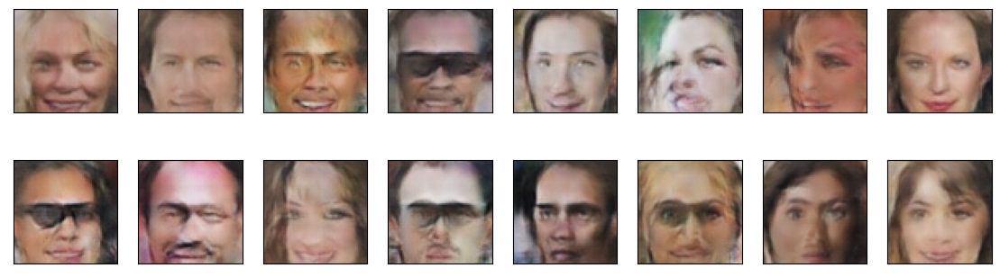

Starting Epoch [18/50]...
2024-11-01 11:57:50 | Epoch [18/50] | Batch 0/509 | d_loss: 0.0248 | g_loss: 5.2121
2024-11-01 11:57:55 | Epoch [18/50] | Batch 50/509 | d_loss: 0.7827 | g_loss: 8.9458
2024-11-01 11:57:59 | Epoch [18/50] | Batch 100/509 | d_loss: 0.0106 | g_loss: 5.5018
2024-11-01 11:58:03 | Epoch [18/50] | Batch 150/509 | d_loss: 0.0226 | g_loss: 4.2141
2024-11-01 11:58:08 | Epoch [18/50] | Batch 200/509 | d_loss: 0.0243 | g_loss: 5.6483
2024-11-01 11:58:12 | Epoch [18/50] | Batch 250/509 | d_loss: 0.0207 | g_loss: 11.6486
2024-11-01 11:58:16 | Epoch [18/50] | Batch 300/509 | d_loss: 0.0278 | g_loss: 4.9700
2024-11-01 11:58:21 | Epoch [18/50] | Batch 350/509 | d_loss: 4.9825 | g_loss: 2.9565
2024-11-01 11:58:25 | Epoch [18/50] | Batch 400/509 | d_loss: 0.0791 | g_loss: 3.9887
2024-11-01 11:58:30 | Epoch [18/50] | Batch 450/509 | d_loss: 0.0154 | g_loss: 7.0912
2024-11-01 11:58:34 | Epoch [18/50] | Batch 500/509 | d_loss: 0.0039 | g_loss: 9.1795
End of Epoch [18/50]. Generati

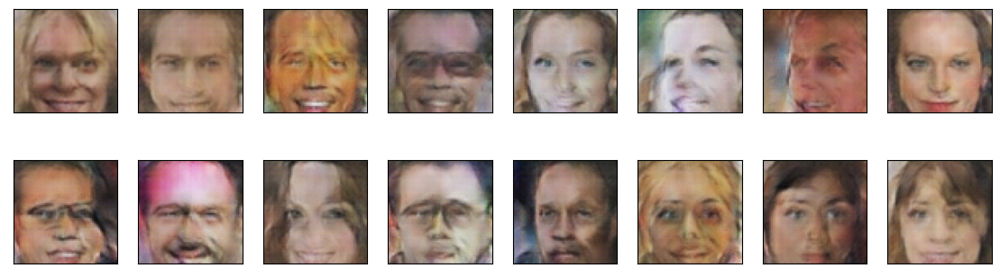

Starting Epoch [19/50]...
2024-11-01 11:58:35 | Epoch [19/50] | Batch 0/509 | d_loss: 0.0025 | g_loss: 11.5669
2024-11-01 11:58:39 | Epoch [19/50] | Batch 50/509 | d_loss: 0.0301 | g_loss: 3.9968
2024-11-01 11:58:44 | Epoch [19/50] | Batch 100/509 | d_loss: 0.0124 | g_loss: 6.5121
2024-11-01 11:58:48 | Epoch [19/50] | Batch 150/509 | d_loss: 0.0038 | g_loss: 6.2330
2024-11-01 11:58:52 | Epoch [19/50] | Batch 200/509 | d_loss: 0.0176 | g_loss: 5.3853
2024-11-01 11:58:57 | Epoch [19/50] | Batch 250/509 | d_loss: 0.0016 | g_loss: 10.1952
2024-11-01 11:59:01 | Epoch [19/50] | Batch 300/509 | d_loss: 0.5402 | g_loss: 9.1968
2024-11-01 11:59:06 | Epoch [19/50] | Batch 350/509 | d_loss: 0.0030 | g_loss: 8.0981
2024-11-01 11:59:10 | Epoch [19/50] | Batch 400/509 | d_loss: 0.1944 | g_loss: 4.1561
2024-11-01 11:59:14 | Epoch [19/50] | Batch 450/509 | d_loss: 0.0667 | g_loss: 8.9954
2024-11-01 11:59:19 | Epoch [19/50] | Batch 500/509 | d_loss: 5.4132 | g_loss: 10.8942
End of Epoch [19/50]. Genera

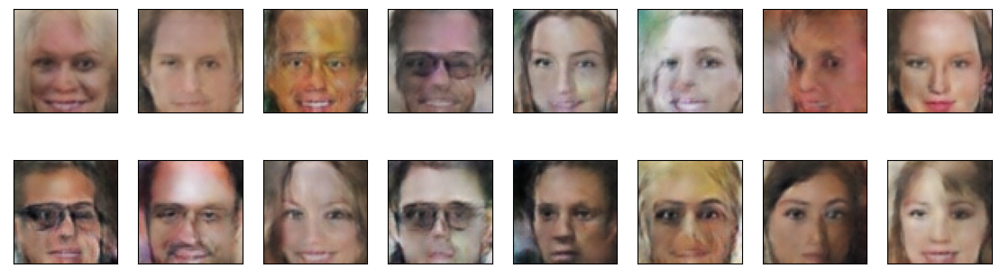

Starting Epoch [20/50]...
2024-11-01 11:59:20 | Epoch [20/50] | Batch 0/509 | d_loss: 0.0148 | g_loss: 4.7787
2024-11-01 11:59:24 | Epoch [20/50] | Batch 50/509 | d_loss: 0.0207 | g_loss: 6.5357
2024-11-01 11:59:28 | Epoch [20/50] | Batch 100/509 | d_loss: 0.0091 | g_loss: 9.5716
2024-11-01 11:59:33 | Epoch [20/50] | Batch 150/509 | d_loss: 0.0145 | g_loss: 5.5174
2024-11-01 11:59:37 | Epoch [20/50] | Batch 200/509 | d_loss: 0.0132 | g_loss: 7.3492
2024-11-01 11:59:42 | Epoch [20/50] | Batch 250/509 | d_loss: 0.0142 | g_loss: 5.8642
2024-11-01 11:59:46 | Epoch [20/50] | Batch 300/509 | d_loss: 0.0462 | g_loss: 4.5436
2024-11-01 11:59:50 | Epoch [20/50] | Batch 350/509 | d_loss: 0.0664 | g_loss: 3.3633
2024-11-01 11:59:55 | Epoch [20/50] | Batch 400/509 | d_loss: 0.0211 | g_loss: 9.4318
2024-11-01 11:59:59 | Epoch [20/50] | Batch 450/509 | d_loss: 0.0148 | g_loss: 8.0922
2024-11-01 12:00:03 | Epoch [20/50] | Batch 500/509 | d_loss: 0.0361 | g_loss: 6.8665
End of Epoch [20/50]. Generatin

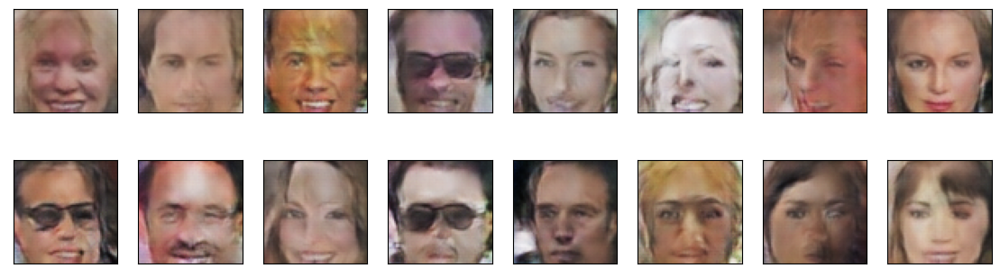

Starting Epoch [21/50]...
2024-11-01 12:00:05 | Epoch [21/50] | Batch 0/509 | d_loss: 2.2593 | g_loss: 8.8193
2024-11-01 12:00:09 | Epoch [21/50] | Batch 50/509 | d_loss: 0.0284 | g_loss: 4.9882
2024-11-01 12:00:13 | Epoch [21/50] | Batch 100/509 | d_loss: 0.0158 | g_loss: 5.7306
2024-11-01 12:00:18 | Epoch [21/50] | Batch 150/509 | d_loss: 0.1256 | g_loss: 11.0316
2024-11-01 12:00:22 | Epoch [21/50] | Batch 200/509 | d_loss: 0.0397 | g_loss: 12.3839
2024-11-01 12:00:26 | Epoch [21/50] | Batch 250/509 | d_loss: 0.0805 | g_loss: 8.4563
2024-11-01 12:00:30 | Epoch [21/50] | Batch 300/509 | d_loss: 0.0427 | g_loss: 4.1477
2024-11-01 12:00:35 | Epoch [21/50] | Batch 350/509 | d_loss: 0.0179 | g_loss: 5.6431
2024-11-01 12:00:39 | Epoch [21/50] | Batch 400/509 | d_loss: 0.1020 | g_loss: 6.5193
2024-11-01 12:00:44 | Epoch [21/50] | Batch 450/509 | d_loss: 2.1800 | g_loss: 16.4378
2024-11-01 12:00:48 | Epoch [21/50] | Batch 500/509 | d_loss: 0.4672 | g_loss: 3.7951
End of Epoch [21/50]. Genera

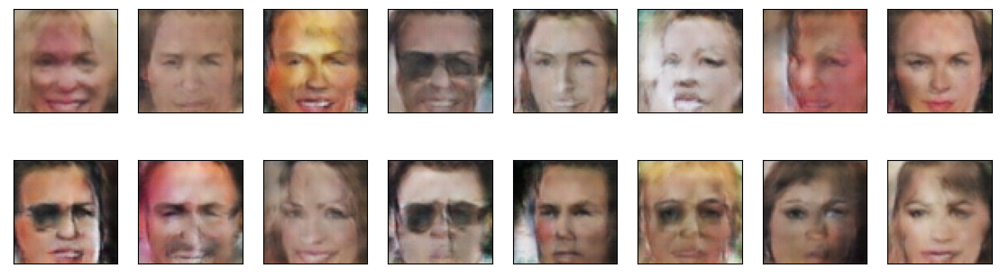

Starting Epoch [22/50]...
2024-11-01 12:00:49 | Epoch [22/50] | Batch 0/509 | d_loss: 0.4998 | g_loss: 4.7202
2024-11-01 12:00:53 | Epoch [22/50] | Batch 50/509 | d_loss: 0.0604 | g_loss: 10.0398
2024-11-01 12:00:58 | Epoch [22/50] | Batch 100/509 | d_loss: 0.0262 | g_loss: 4.9513
2024-11-01 12:01:02 | Epoch [22/50] | Batch 150/509 | d_loss: 0.0151 | g_loss: 8.0194
2024-11-01 12:01:06 | Epoch [22/50] | Batch 200/509 | d_loss: 0.0175 | g_loss: 5.1620
2024-11-01 12:01:11 | Epoch [22/50] | Batch 250/509 | d_loss: 0.1389 | g_loss: 3.8208
2024-11-01 12:01:15 | Epoch [22/50] | Batch 300/509 | d_loss: 0.0273 | g_loss: 6.5428
2024-11-01 12:01:20 | Epoch [22/50] | Batch 350/509 | d_loss: 0.0221 | g_loss: 7.0379
2024-11-01 12:01:24 | Epoch [22/50] | Batch 400/509 | d_loss: 0.0042 | g_loss: 9.9802
2024-11-01 12:01:28 | Epoch [22/50] | Batch 450/509 | d_loss: 0.0224 | g_loss: 4.8056
2024-11-01 12:01:33 | Epoch [22/50] | Batch 500/509 | d_loss: 0.0378 | g_loss: 7.2007
End of Epoch [22/50]. Generati

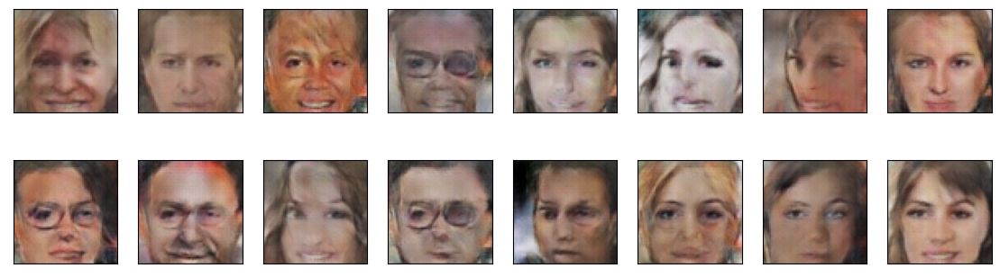

Starting Epoch [23/50]...
2024-11-01 12:01:34 | Epoch [23/50] | Batch 0/509 | d_loss: 0.3374 | g_loss: 4.2043
2024-11-01 12:01:38 | Epoch [23/50] | Batch 50/509 | d_loss: 0.0168 | g_loss: 5.0315
2024-11-01 12:01:42 | Epoch [23/50] | Batch 100/509 | d_loss: 0.0364 | g_loss: 5.9216
2024-11-01 12:01:47 | Epoch [23/50] | Batch 150/509 | d_loss: 0.1518 | g_loss: 4.0212
2024-11-01 12:01:51 | Epoch [23/50] | Batch 200/509 | d_loss: 0.1833 | g_loss: 7.6437
2024-11-01 12:01:56 | Epoch [23/50] | Batch 250/509 | d_loss: 0.2834 | g_loss: 5.4472
2024-11-01 12:02:00 | Epoch [23/50] | Batch 300/509 | d_loss: 0.0791 | g_loss: 3.1561
2024-11-01 12:02:04 | Epoch [23/50] | Batch 350/509 | d_loss: 0.0117 | g_loss: 4.2792
2024-11-01 12:02:09 | Epoch [23/50] | Batch 400/509 | d_loss: 0.2099 | g_loss: 7.6678
2024-11-01 12:02:13 | Epoch [23/50] | Batch 450/509 | d_loss: 0.0621 | g_loss: 7.3507
2024-11-01 12:02:17 | Epoch [23/50] | Batch 500/509 | d_loss: 0.0136 | g_loss: 5.4141
End of Epoch [23/50]. Generatin

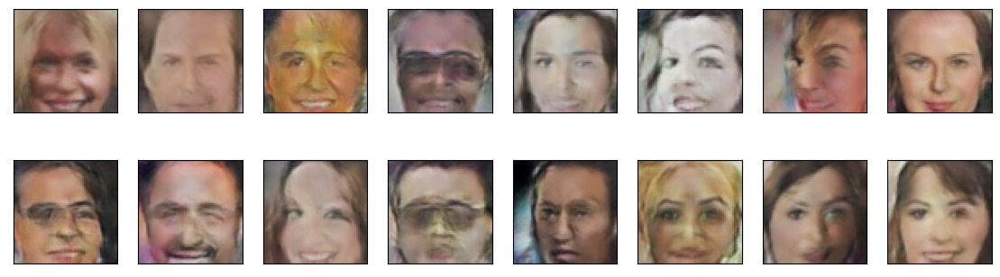

Starting Epoch [24/50]...
2024-11-01 12:02:19 | Epoch [24/50] | Batch 0/509 | d_loss: 0.0806 | g_loss: 4.5613
2024-11-01 12:02:23 | Epoch [24/50] | Batch 50/509 | d_loss: 0.0275 | g_loss: 5.3325
2024-11-01 12:02:27 | Epoch [24/50] | Batch 100/509 | d_loss: 0.3242 | g_loss: 5.2434
2024-11-01 12:02:32 | Epoch [24/50] | Batch 150/509 | d_loss: 0.1027 | g_loss: 3.8235
2024-11-01 12:02:36 | Epoch [24/50] | Batch 200/509 | d_loss: 0.0081 | g_loss: 6.2951
2024-11-01 12:02:40 | Epoch [24/50] | Batch 250/509 | d_loss: 0.0147 | g_loss: 8.8968
2024-11-01 12:02:45 | Epoch [24/50] | Batch 300/509 | d_loss: 0.0290 | g_loss: 5.1568
2024-11-01 12:02:49 | Epoch [24/50] | Batch 350/509 | d_loss: 0.0052 | g_loss: 6.2320
2024-11-01 12:02:54 | Epoch [24/50] | Batch 400/509 | d_loss: 0.0996 | g_loss: 5.9552
2024-11-01 12:02:58 | Epoch [24/50] | Batch 450/509 | d_loss: 0.1457 | g_loss: 4.5404
2024-11-01 12:03:03 | Epoch [24/50] | Batch 500/509 | d_loss: 0.0293 | g_loss: 11.3698
End of Epoch [24/50]. Generati

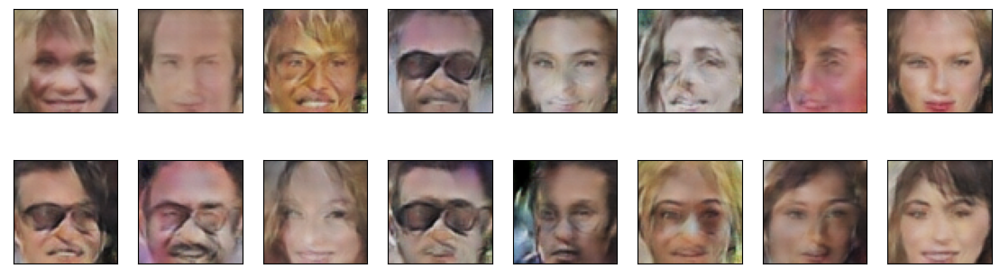

Starting Epoch [25/50]...
2024-11-01 12:03:04 | Epoch [25/50] | Batch 0/509 | d_loss: 0.0050 | g_loss: 8.2564
2024-11-01 12:03:08 | Epoch [25/50] | Batch 50/509 | d_loss: 0.0865 | g_loss: 4.5051
2024-11-01 12:03:12 | Epoch [25/50] | Batch 100/509 | d_loss: 0.0074 | g_loss: 5.8870
2024-11-01 12:03:17 | Epoch [25/50] | Batch 150/509 | d_loss: 0.0077 | g_loss: 5.6359
2024-11-01 12:03:21 | Epoch [25/50] | Batch 200/509 | d_loss: 0.0852 | g_loss: 4.8811
2024-11-01 12:03:26 | Epoch [25/50] | Batch 250/509 | d_loss: 0.0485 | g_loss: 4.8362
2024-11-01 12:03:30 | Epoch [25/50] | Batch 300/509 | d_loss: 0.0135 | g_loss: 6.3167
2024-11-01 12:03:35 | Epoch [25/50] | Batch 350/509 | d_loss: 0.1420 | g_loss: 6.6710
2024-11-01 12:03:39 | Epoch [25/50] | Batch 400/509 | d_loss: 0.0115 | g_loss: 5.9506
2024-11-01 12:03:43 | Epoch [25/50] | Batch 450/509 | d_loss: 1.1619 | g_loss: 1.9870
2024-11-01 12:03:48 | Epoch [25/50] | Batch 500/509 | d_loss: 0.0329 | g_loss: 5.4421
End of Epoch [25/50]. Generatin

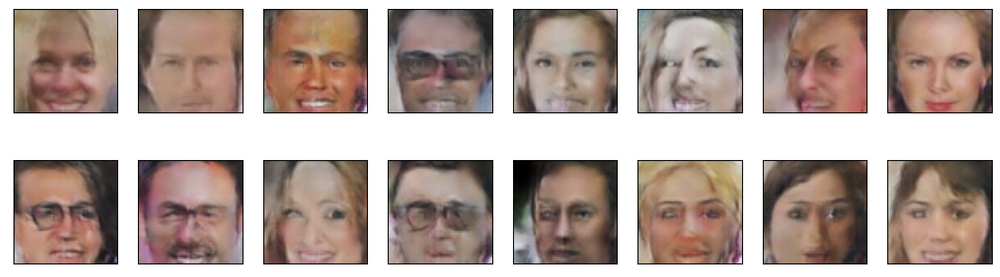

Starting Epoch [26/50]...
2024-11-01 12:03:49 | Epoch [26/50] | Batch 0/509 | d_loss: 0.0860 | g_loss: 4.6479
2024-11-01 12:03:53 | Epoch [26/50] | Batch 50/509 | d_loss: 0.0511 | g_loss: 5.3690
2024-11-01 12:03:58 | Epoch [26/50] | Batch 100/509 | d_loss: 0.1711 | g_loss: 6.5337
2024-11-01 12:04:02 | Epoch [26/50] | Batch 150/509 | d_loss: 0.0349 | g_loss: 6.0342
2024-11-01 12:04:07 | Epoch [26/50] | Batch 200/509 | d_loss: 0.1703 | g_loss: 3.9430
2024-11-01 12:04:12 | Epoch [26/50] | Batch 250/509 | d_loss: 0.0092 | g_loss: 10.5828
2024-11-01 12:04:17 | Epoch [26/50] | Batch 300/509 | d_loss: 0.0154 | g_loss: 3.1788
2024-11-01 12:04:21 | Epoch [26/50] | Batch 350/509 | d_loss: 0.0194 | g_loss: 10.3379
2024-11-01 12:04:25 | Epoch [26/50] | Batch 400/509 | d_loss: 0.0952 | g_loss: 6.1445
2024-11-01 12:04:30 | Epoch [26/50] | Batch 450/509 | d_loss: 0.1226 | g_loss: 5.8255
2024-11-01 12:04:34 | Epoch [26/50] | Batch 500/509 | d_loss: 0.1451 | g_loss: 4.8793
End of Epoch [26/50]. Generat

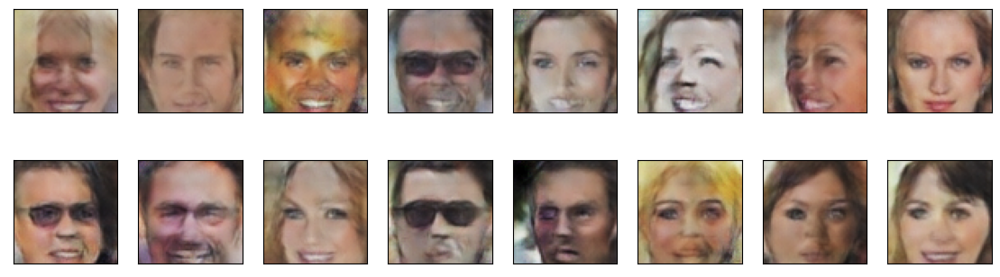

Starting Epoch [27/50]...
2024-11-01 12:04:35 | Epoch [27/50] | Batch 0/509 | d_loss: 0.0278 | g_loss: 4.7094
2024-11-01 12:04:40 | Epoch [27/50] | Batch 50/509 | d_loss: 0.0192 | g_loss: 6.1117
2024-11-01 12:04:44 | Epoch [27/50] | Batch 100/509 | d_loss: 0.0536 | g_loss: 5.2208
2024-11-01 12:04:48 | Epoch [27/50] | Batch 150/509 | d_loss: 0.5674 | g_loss: 8.4689
2024-11-01 12:04:53 | Epoch [27/50] | Batch 200/509 | d_loss: 0.4626 | g_loss: 7.8127
2024-11-01 12:04:57 | Epoch [27/50] | Batch 250/509 | d_loss: 0.0320 | g_loss: 4.6084
2024-11-01 12:05:02 | Epoch [27/50] | Batch 300/509 | d_loss: 0.0131 | g_loss: 7.7717
2024-11-01 12:05:06 | Epoch [27/50] | Batch 350/509 | d_loss: 0.0378 | g_loss: 5.8781
2024-11-01 12:05:10 | Epoch [27/50] | Batch 400/509 | d_loss: 0.1814 | g_loss: 5.0112
2024-11-01 12:05:15 | Epoch [27/50] | Batch 450/509 | d_loss: 0.1858 | g_loss: 6.1910
2024-11-01 12:05:19 | Epoch [27/50] | Batch 500/509 | d_loss: 0.0982 | g_loss: 4.6765
End of Epoch [27/50]. Generatin

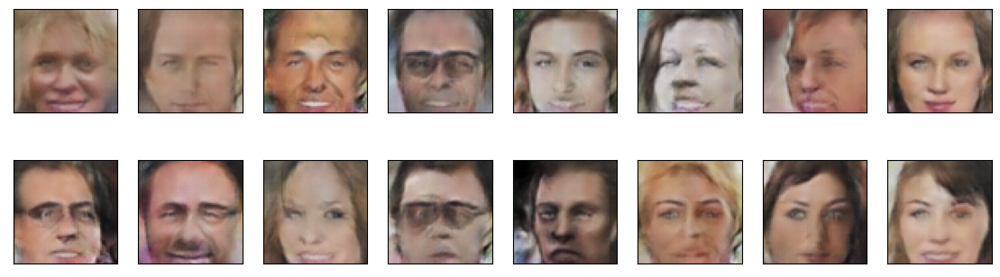

Starting Epoch [28/50]...
2024-11-01 12:05:20 | Epoch [28/50] | Batch 0/509 | d_loss: 0.0056 | g_loss: 7.0250
2024-11-01 12:05:25 | Epoch [28/50] | Batch 50/509 | d_loss: 0.0054 | g_loss: 9.5267
2024-11-01 12:05:29 | Epoch [28/50] | Batch 100/509 | d_loss: 0.1940 | g_loss: 5.6027
2024-11-01 12:05:33 | Epoch [28/50] | Batch 150/509 | d_loss: 0.1189 | g_loss: 4.0951
2024-11-01 12:05:38 | Epoch [28/50] | Batch 200/509 | d_loss: 0.0216 | g_loss: 6.1099
2024-11-01 12:05:42 | Epoch [28/50] | Batch 250/509 | d_loss: 0.0486 | g_loss: 2.5276
2024-11-01 12:05:46 | Epoch [28/50] | Batch 300/509 | d_loss: 0.0404 | g_loss: 5.8934
2024-11-01 12:05:51 | Epoch [28/50] | Batch 350/509 | d_loss: 0.0416 | g_loss: 5.4125
2024-11-01 12:05:55 | Epoch [28/50] | Batch 400/509 | d_loss: 0.0033 | g_loss: 8.7350
2024-11-01 12:06:00 | Epoch [28/50] | Batch 450/509 | d_loss: 0.0461 | g_loss: 5.6102
2024-11-01 12:06:04 | Epoch [28/50] | Batch 500/509 | d_loss: 0.0144 | g_loss: 6.1569
End of Epoch [28/50]. Generatin

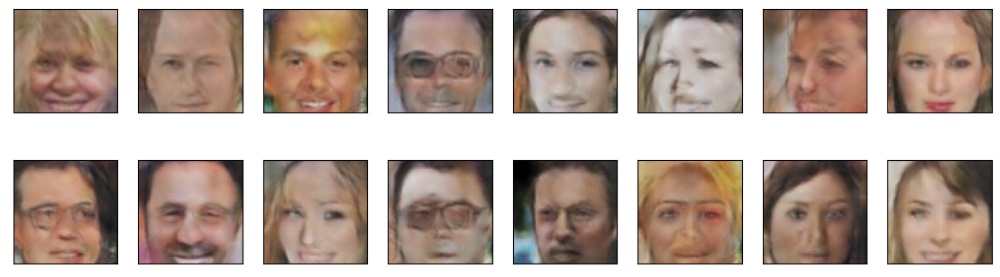

Starting Epoch [29/50]...
2024-11-01 12:06:05 | Epoch [29/50] | Batch 0/509 | d_loss: 0.0193 | g_loss: 4.1463
2024-11-01 12:06:09 | Epoch [29/50] | Batch 50/509 | d_loss: 0.1364 | g_loss: 4.5762
2024-11-01 12:06:14 | Epoch [29/50] | Batch 100/509 | d_loss: 0.0072 | g_loss: 6.1880
2024-11-01 12:06:18 | Epoch [29/50] | Batch 150/509 | d_loss: 0.1162 | g_loss: 6.6899
2024-11-01 12:06:22 | Epoch [29/50] | Batch 200/509 | d_loss: 0.0165 | g_loss: 3.6766
2024-11-01 12:06:27 | Epoch [29/50] | Batch 250/509 | d_loss: 0.0255 | g_loss: 5.2982
2024-11-01 12:06:31 | Epoch [29/50] | Batch 300/509 | d_loss: 0.0041 | g_loss: 7.5688
2024-11-01 12:06:35 | Epoch [29/50] | Batch 350/509 | d_loss: 0.1301 | g_loss: 4.3377
2024-11-01 12:06:40 | Epoch [29/50] | Batch 400/509 | d_loss: 0.1589 | g_loss: 7.4803
2024-11-01 12:06:44 | Epoch [29/50] | Batch 450/509 | d_loss: 0.0178 | g_loss: 9.0958
2024-11-01 12:06:49 | Epoch [29/50] | Batch 500/509 | d_loss: 0.5258 | g_loss: 3.1472
End of Epoch [29/50]. Generatin

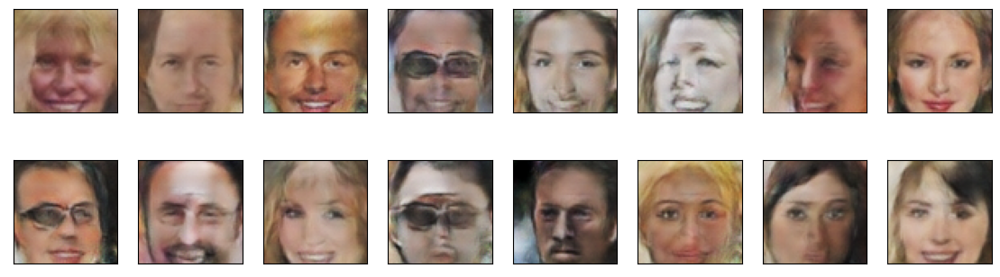

Starting Epoch [30/50]...
2024-11-01 12:06:50 | Epoch [30/50] | Batch 0/509 | d_loss: 0.1115 | g_loss: 3.7097
2024-11-01 12:06:54 | Epoch [30/50] | Batch 50/509 | d_loss: 0.0118 | g_loss: 5.4082
2024-11-01 12:06:58 | Epoch [30/50] | Batch 100/509 | d_loss: 0.1945 | g_loss: 5.2535
2024-11-01 12:07:03 | Epoch [30/50] | Batch 150/509 | d_loss: 0.1258 | g_loss: 4.4539
2024-11-01 12:07:07 | Epoch [30/50] | Batch 200/509 | d_loss: 0.0303 | g_loss: 5.6848
2024-11-01 12:07:11 | Epoch [30/50] | Batch 250/509 | d_loss: 0.0685 | g_loss: 2.4693
2024-11-01 12:07:16 | Epoch [30/50] | Batch 300/509 | d_loss: 0.0891 | g_loss: 6.9814
2024-11-01 12:07:20 | Epoch [30/50] | Batch 350/509 | d_loss: 0.1182 | g_loss: 4.2218
2024-11-01 12:07:24 | Epoch [30/50] | Batch 400/509 | d_loss: 0.0138 | g_loss: 6.3463
2024-11-01 12:07:28 | Epoch [30/50] | Batch 450/509 | d_loss: 0.0184 | g_loss: 7.5012
2024-11-01 12:07:33 | Epoch [30/50] | Batch 500/509 | d_loss: 0.0559 | g_loss: 4.2030
End of Epoch [30/50]. Generatin

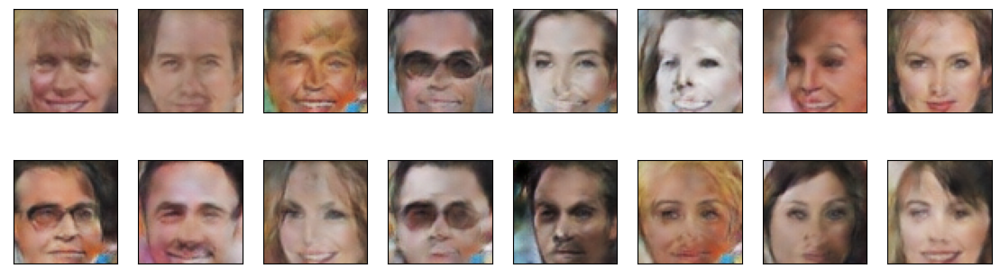

Starting Epoch [31/50]...
2024-11-01 12:07:34 | Epoch [31/50] | Batch 0/509 | d_loss: 0.0069 | g_loss: 6.8890
2024-11-01 12:07:38 | Epoch [31/50] | Batch 50/509 | d_loss: 0.1009 | g_loss: 2.7109
2024-11-01 12:07:42 | Epoch [31/50] | Batch 100/509 | d_loss: 0.0473 | g_loss: 4.8590
2024-11-01 12:07:47 | Epoch [31/50] | Batch 150/509 | d_loss: 0.0124 | g_loss: 7.1581
2024-11-01 12:07:51 | Epoch [31/50] | Batch 200/509 | d_loss: 0.0075 | g_loss: 6.7346
2024-11-01 12:07:55 | Epoch [31/50] | Batch 250/509 | d_loss: 0.0081 | g_loss: 5.8864
2024-11-01 12:08:00 | Epoch [31/50] | Batch 300/509 | d_loss: 0.0069 | g_loss: 7.6111
2024-11-01 12:08:04 | Epoch [31/50] | Batch 350/509 | d_loss: 0.2321 | g_loss: 7.7154
2024-11-01 12:08:08 | Epoch [31/50] | Batch 400/509 | d_loss: 0.0632 | g_loss: 5.8040
2024-11-01 12:08:12 | Epoch [31/50] | Batch 450/509 | d_loss: 0.0481 | g_loss: 4.4736
2024-11-01 12:08:17 | Epoch [31/50] | Batch 500/509 | d_loss: 0.4742 | g_loss: 8.5226
End of Epoch [31/50]. Generatin

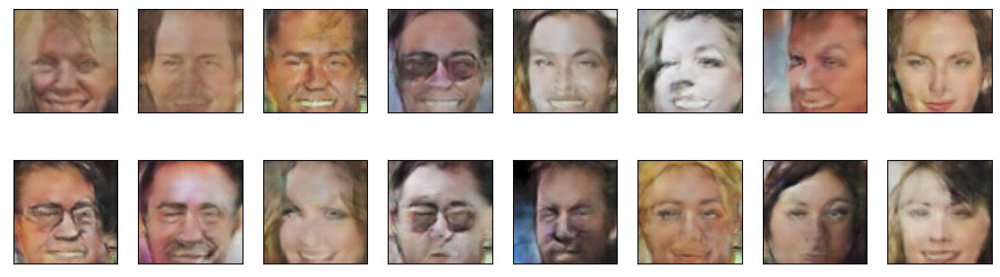

Starting Epoch [32/50]...
2024-11-01 12:08:18 | Epoch [32/50] | Batch 0/509 | d_loss: 0.1610 | g_loss: 6.6719
2024-11-01 12:08:22 | Epoch [32/50] | Batch 50/509 | d_loss: 0.4077 | g_loss: 5.5365
2024-11-01 12:08:26 | Epoch [32/50] | Batch 100/509 | d_loss: 0.1152 | g_loss: 2.7338
2024-11-01 12:08:31 | Epoch [32/50] | Batch 150/509 | d_loss: 0.0063 | g_loss: 5.5214
2024-11-01 12:08:35 | Epoch [32/50] | Batch 200/509 | d_loss: 0.0042 | g_loss: 8.4031
2024-11-01 12:08:39 | Epoch [32/50] | Batch 250/509 | d_loss: 0.0549 | g_loss: 8.1618
2024-11-01 12:08:43 | Epoch [32/50] | Batch 300/509 | d_loss: 0.0118 | g_loss: 6.3787
2024-11-01 12:08:48 | Epoch [32/50] | Batch 350/509 | d_loss: 0.0038 | g_loss: 6.8241
2024-11-01 12:08:52 | Epoch [32/50] | Batch 400/509 | d_loss: 0.0171 | g_loss: 4.6549
2024-11-01 12:08:56 | Epoch [32/50] | Batch 450/509 | d_loss: 0.4297 | g_loss: 3.6937
2024-11-01 12:09:01 | Epoch [32/50] | Batch 500/509 | d_loss: 0.0320 | g_loss: 5.1768
End of Epoch [32/50]. Generatin

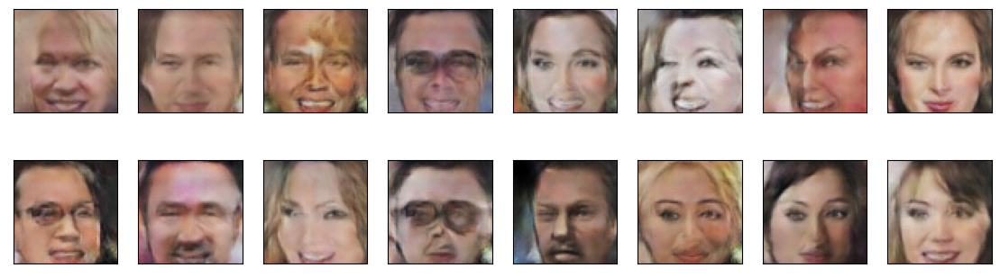

Starting Epoch [33/50]...
2024-11-01 12:09:02 | Epoch [33/50] | Batch 0/509 | d_loss: 0.0633 | g_loss: 9.9239
2024-11-01 12:09:06 | Epoch [33/50] | Batch 50/509 | d_loss: 0.1078 | g_loss: 4.1401
2024-11-01 12:09:10 | Epoch [33/50] | Batch 100/509 | d_loss: 0.0044 | g_loss: 6.1748
2024-11-01 12:09:14 | Epoch [33/50] | Batch 150/509 | d_loss: 0.0407 | g_loss: 3.8870
2024-11-01 12:09:19 | Epoch [33/50] | Batch 200/509 | d_loss: 0.1434 | g_loss: 5.7568
2024-11-01 12:09:23 | Epoch [33/50] | Batch 250/509 | d_loss: 0.2877 | g_loss: 3.4390
2024-11-01 12:09:27 | Epoch [33/50] | Batch 300/509 | d_loss: 0.0257 | g_loss: 3.8494
2024-11-01 12:09:32 | Epoch [33/50] | Batch 350/509 | d_loss: 0.0047 | g_loss: 5.7587
2024-11-01 12:09:36 | Epoch [33/50] | Batch 400/509 | d_loss: 0.0037 | g_loss: 8.5073
2024-11-01 12:09:40 | Epoch [33/50] | Batch 450/509 | d_loss: 0.0036 | g_loss: 12.7059
2024-11-01 12:09:44 | Epoch [33/50] | Batch 500/509 | d_loss: 0.0267 | g_loss: 4.8329
End of Epoch [33/50]. Generati

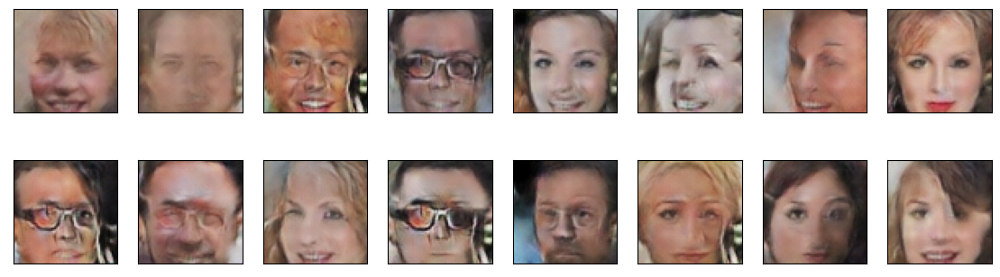

Starting Epoch [34/50]...
2024-11-01 12:09:46 | Epoch [34/50] | Batch 0/509 | d_loss: 0.4537 | g_loss: 11.6617
2024-11-01 12:09:50 | Epoch [34/50] | Batch 50/509 | d_loss: 0.0720 | g_loss: 3.9747
2024-11-01 12:09:54 | Epoch [34/50] | Batch 100/509 | d_loss: 0.2580 | g_loss: 9.1814
2024-11-01 12:09:58 | Epoch [34/50] | Batch 150/509 | d_loss: 0.1694 | g_loss: 3.4956
2024-11-01 12:10:03 | Epoch [34/50] | Batch 200/509 | d_loss: 0.1345 | g_loss: 4.7884
2024-11-01 12:10:07 | Epoch [34/50] | Batch 250/509 | d_loss: 0.2119 | g_loss: 3.0466
2024-11-01 12:10:11 | Epoch [34/50] | Batch 300/509 | d_loss: 0.0342 | g_loss: 5.7440
2024-11-01 12:10:16 | Epoch [34/50] | Batch 350/509 | d_loss: 0.7043 | g_loss: 4.7365
2024-11-01 12:10:20 | Epoch [34/50] | Batch 400/509 | d_loss: 0.0640 | g_loss: 6.4284
2024-11-01 12:10:24 | Epoch [34/50] | Batch 450/509 | d_loss: 0.0520 | g_loss: 4.1755
2024-11-01 12:10:28 | Epoch [34/50] | Batch 500/509 | d_loss: 0.0303 | g_loss: 7.0116
End of Epoch [34/50]. Generati

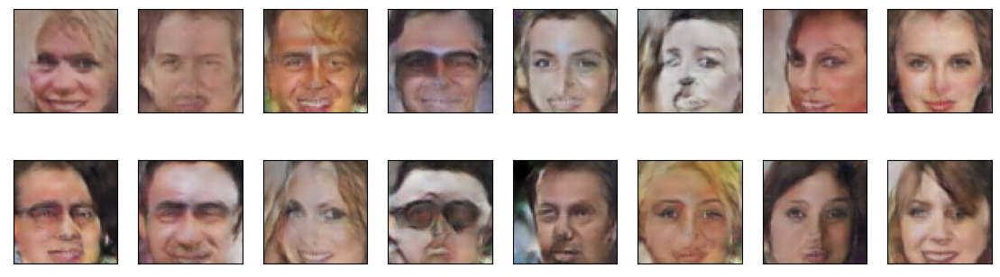

Starting Epoch [35/50]...
2024-11-01 12:10:30 | Epoch [35/50] | Batch 0/509 | d_loss: 0.0015 | g_loss: 8.7203
2024-11-01 12:10:34 | Epoch [35/50] | Batch 50/509 | d_loss: 0.1075 | g_loss: 6.6009
2024-11-01 12:10:38 | Epoch [35/50] | Batch 100/509 | d_loss: 0.0039 | g_loss: 10.3454
2024-11-01 12:10:42 | Epoch [35/50] | Batch 150/509 | d_loss: 0.0290 | g_loss: 6.6270
2024-11-01 12:10:47 | Epoch [35/50] | Batch 200/509 | d_loss: 0.0778 | g_loss: 6.2806
2024-11-01 12:10:51 | Epoch [35/50] | Batch 250/509 | d_loss: 0.0433 | g_loss: 3.7688
2024-11-01 12:10:55 | Epoch [35/50] | Batch 300/509 | d_loss: 0.0366 | g_loss: 5.7457
2024-11-01 12:11:00 | Epoch [35/50] | Batch 350/509 | d_loss: 0.0078 | g_loss: 10.3852
2024-11-01 12:11:04 | Epoch [35/50] | Batch 400/509 | d_loss: 0.0005 | g_loss: 7.6322
2024-11-01 12:11:08 | Epoch [35/50] | Batch 450/509 | d_loss: 0.1136 | g_loss: 4.8535
2024-11-01 12:11:12 | Epoch [35/50] | Batch 500/509 | d_loss: 0.0069 | g_loss: 8.8658
End of Epoch [35/50]. Generat

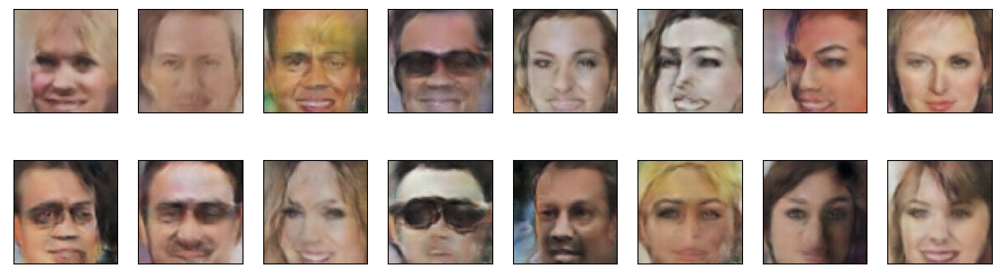

Starting Epoch [36/50]...
2024-11-01 12:11:14 | Epoch [36/50] | Batch 0/509 | d_loss: 0.0121 | g_loss: 5.6733
2024-11-01 12:11:18 | Epoch [36/50] | Batch 50/509 | d_loss: 0.0019 | g_loss: 7.9903
2024-11-01 12:11:22 | Epoch [36/50] | Batch 100/509 | d_loss: 0.0136 | g_loss: 5.1428
2024-11-01 12:11:26 | Epoch [36/50] | Batch 150/509 | d_loss: 0.2685 | g_loss: 3.4088
2024-11-01 12:11:31 | Epoch [36/50] | Batch 200/509 | d_loss: 0.0518 | g_loss: 4.4773
2024-11-01 12:11:35 | Epoch [36/50] | Batch 250/509 | d_loss: 0.4944 | g_loss: 3.2950
2024-11-01 12:11:39 | Epoch [36/50] | Batch 300/509 | d_loss: 1.1066 | g_loss: 0.0382
2024-11-01 12:11:44 | Epoch [36/50] | Batch 350/509 | d_loss: 2.5652 | g_loss: 12.9780
2024-11-01 12:11:48 | Epoch [36/50] | Batch 400/509 | d_loss: 0.0312 | g_loss: 3.6650
2024-11-01 12:11:52 | Epoch [36/50] | Batch 450/509 | d_loss: 0.0802 | g_loss: 2.8373
2024-11-01 12:11:57 | Epoch [36/50] | Batch 500/509 | d_loss: 0.0095 | g_loss: 5.6086
End of Epoch [36/50]. Generati

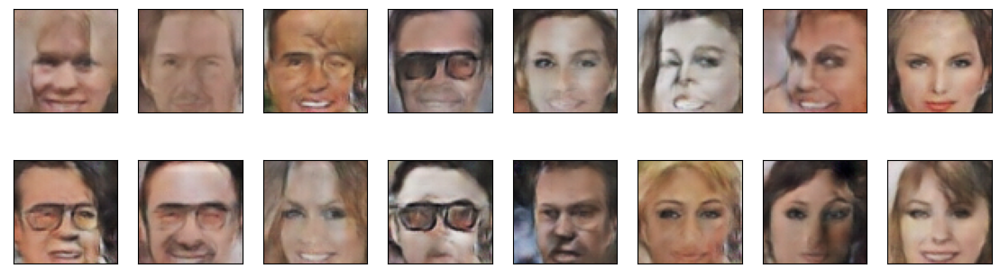

Starting Epoch [37/50]...
2024-11-01 12:11:58 | Epoch [37/50] | Batch 0/509 | d_loss: 0.0025 | g_loss: 8.4780
2024-11-01 12:12:02 | Epoch [37/50] | Batch 50/509 | d_loss: 0.3034 | g_loss: 1.3247
2024-11-01 12:12:06 | Epoch [37/50] | Batch 100/509 | d_loss: 0.0135 | g_loss: 7.2149
2024-11-01 12:12:10 | Epoch [37/50] | Batch 150/509 | d_loss: 0.0043 | g_loss: 7.3510
2024-11-01 12:12:15 | Epoch [37/50] | Batch 200/509 | d_loss: 0.1894 | g_loss: 5.7965
2024-11-01 12:12:19 | Epoch [37/50] | Batch 250/509 | d_loss: 0.0093 | g_loss: 6.0003
2024-11-01 12:12:24 | Epoch [37/50] | Batch 300/509 | d_loss: 0.0102 | g_loss: 5.7857
2024-11-01 12:12:28 | Epoch [37/50] | Batch 350/509 | d_loss: 0.0163 | g_loss: 5.7371
2024-11-01 12:12:32 | Epoch [37/50] | Batch 400/509 | d_loss: 0.0032 | g_loss: 10.4543
2024-11-01 12:12:36 | Epoch [37/50] | Batch 450/509 | d_loss: 0.0103 | g_loss: 5.4654
2024-11-01 12:12:41 | Epoch [37/50] | Batch 500/509 | d_loss: 0.0038 | g_loss: 7.9545
End of Epoch [37/50]. Generati

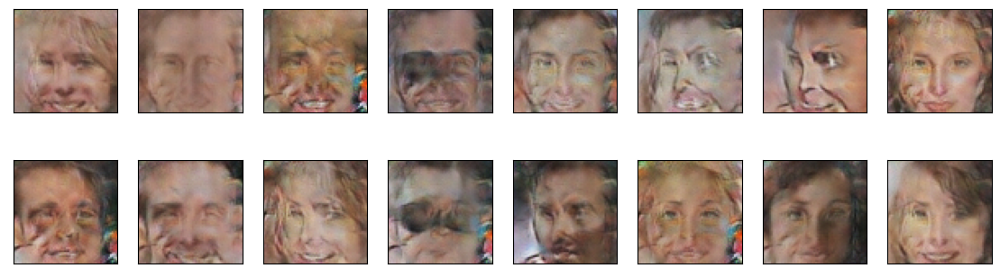

Starting Epoch [38/50]...
2024-11-01 12:12:42 | Epoch [38/50] | Batch 0/509 | d_loss: 0.0151 | g_loss: 9.9111
2024-11-01 12:12:46 | Epoch [38/50] | Batch 50/509 | d_loss: 0.8087 | g_loss: 2.6488
2024-11-01 12:12:50 | Epoch [38/50] | Batch 100/509 | d_loss: 0.0290 | g_loss: 6.4090
2024-11-01 12:12:55 | Epoch [38/50] | Batch 150/509 | d_loss: 0.0825 | g_loss: 6.9310
2024-11-01 12:12:59 | Epoch [38/50] | Batch 200/509 | d_loss: 0.2977 | g_loss: 3.1506
2024-11-01 12:13:03 | Epoch [38/50] | Batch 250/509 | d_loss: 0.0928 | g_loss: 4.4992
2024-11-01 12:13:08 | Epoch [38/50] | Batch 300/509 | d_loss: 0.0647 | g_loss: 5.0298
2024-11-01 12:13:12 | Epoch [38/50] | Batch 350/509 | d_loss: 0.0132 | g_loss: 7.0890
2024-11-01 12:13:16 | Epoch [38/50] | Batch 400/509 | d_loss: 0.0454 | g_loss: 4.8004
2024-11-01 12:13:21 | Epoch [38/50] | Batch 450/509 | d_loss: 0.0526 | g_loss: 4.3594
2024-11-01 12:13:25 | Epoch [38/50] | Batch 500/509 | d_loss: 4.0793 | g_loss: 5.4807
End of Epoch [38/50]. Generatin

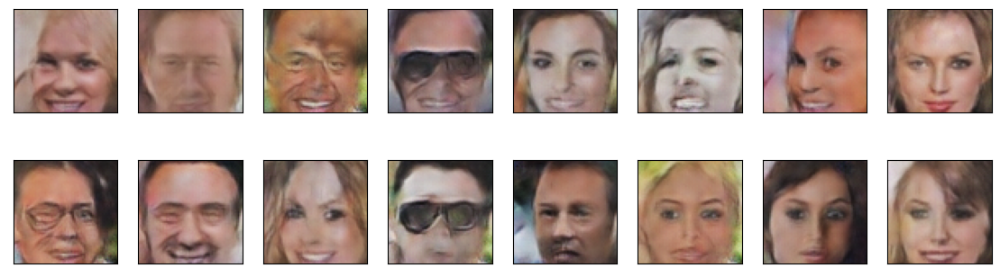

Starting Epoch [39/50]...
2024-11-01 12:13:26 | Epoch [39/50] | Batch 0/509 | d_loss: 0.2175 | g_loss: 4.3970
2024-11-01 12:13:30 | Epoch [39/50] | Batch 50/509 | d_loss: 0.0853 | g_loss: 5.4513
2024-11-01 12:13:35 | Epoch [39/50] | Batch 100/509 | d_loss: 0.1355 | g_loss: 3.7697
2024-11-01 12:13:39 | Epoch [39/50] | Batch 150/509 | d_loss: 0.0315 | g_loss: 4.4323
2024-11-01 12:13:44 | Epoch [39/50] | Batch 200/509 | d_loss: 0.2186 | g_loss: 6.0132
2024-11-01 12:13:48 | Epoch [39/50] | Batch 250/509 | d_loss: 0.0115 | g_loss: 9.9113
2024-11-01 12:13:52 | Epoch [39/50] | Batch 300/509 | d_loss: 0.3281 | g_loss: 3.3079
2024-11-01 12:13:56 | Epoch [39/50] | Batch 350/509 | d_loss: 0.2218 | g_loss: 4.6235
2024-11-01 12:14:01 | Epoch [39/50] | Batch 400/509 | d_loss: 0.0438 | g_loss: 4.4899
2024-11-01 12:14:05 | Epoch [39/50] | Batch 450/509 | d_loss: 0.4407 | g_loss: 7.8902
2024-11-01 12:14:09 | Epoch [39/50] | Batch 500/509 | d_loss: 0.0130 | g_loss: 5.8363
End of Epoch [39/50]. Generatin

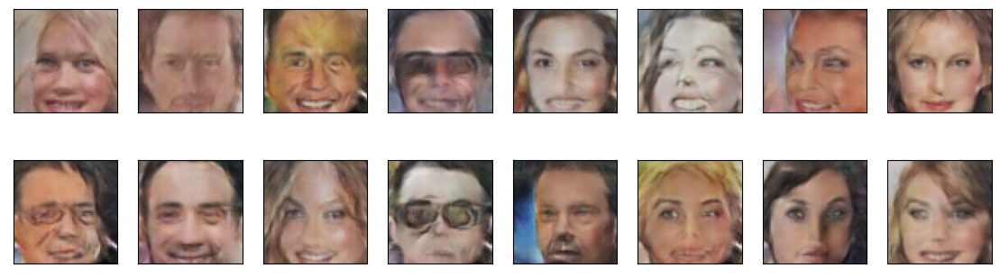

Starting Epoch [40/50]...
2024-11-01 12:14:11 | Epoch [40/50] | Batch 0/509 | d_loss: 0.0221 | g_loss: 5.1964
2024-11-01 12:14:15 | Epoch [40/50] | Batch 50/509 | d_loss: 0.0062 | g_loss: 6.6570
2024-11-01 12:14:19 | Epoch [40/50] | Batch 100/509 | d_loss: 0.0052 | g_loss: 7.7010
2024-11-01 12:14:24 | Epoch [40/50] | Batch 150/509 | d_loss: 0.1290 | g_loss: 4.0179
2024-11-01 12:14:28 | Epoch [40/50] | Batch 200/509 | d_loss: 0.0027 | g_loss: 8.0265
2024-11-01 12:14:32 | Epoch [40/50] | Batch 250/509 | d_loss: 0.0063 | g_loss: 8.5914
2024-11-01 12:14:37 | Epoch [40/50] | Batch 300/509 | d_loss: 0.1541 | g_loss: 4.3146
2024-11-01 12:14:41 | Epoch [40/50] | Batch 350/509 | d_loss: 0.0561 | g_loss: 4.6064
2024-11-01 12:14:45 | Epoch [40/50] | Batch 400/509 | d_loss: 0.0180 | g_loss: 11.2323
2024-11-01 12:14:50 | Epoch [40/50] | Batch 450/509 | d_loss: 0.0624 | g_loss: 6.5905
2024-11-01 12:14:54 | Epoch [40/50] | Batch 500/509 | d_loss: 0.0232 | g_loss: 9.2700
End of Epoch [40/50]. Generati

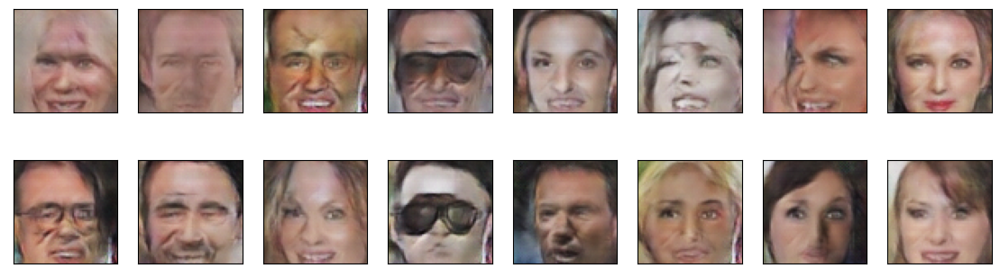

Starting Epoch [41/50]...
2024-11-01 12:14:55 | Epoch [41/50] | Batch 0/509 | d_loss: 0.0991 | g_loss: 10.2455
2024-11-01 12:14:59 | Epoch [41/50] | Batch 50/509 | d_loss: 0.2606 | g_loss: 3.9674
2024-11-01 12:15:04 | Epoch [41/50] | Batch 100/509 | d_loss: 0.1124 | g_loss: 3.2612
2024-11-01 12:15:08 | Epoch [41/50] | Batch 150/509 | d_loss: 0.0160 | g_loss: 6.4409
2024-11-01 12:15:12 | Epoch [41/50] | Batch 200/509 | d_loss: 0.2013 | g_loss: 4.7272
2024-11-01 12:15:17 | Epoch [41/50] | Batch 250/509 | d_loss: 0.0122 | g_loss: 5.9222
2024-11-01 12:15:21 | Epoch [41/50] | Batch 300/509 | d_loss: 0.0612 | g_loss: 4.1125
2024-11-01 12:15:26 | Epoch [41/50] | Batch 350/509 | d_loss: 0.0141 | g_loss: 7.7269
2024-11-01 12:15:30 | Epoch [41/50] | Batch 400/509 | d_loss: 0.2645 | g_loss: 4.0861
2024-11-01 12:15:34 | Epoch [41/50] | Batch 450/509 | d_loss: 0.0113 | g_loss: 5.0100
2024-11-01 12:15:39 | Epoch [41/50] | Batch 500/509 | d_loss: 0.0235 | g_loss: 4.9563
End of Epoch [41/50]. Generati

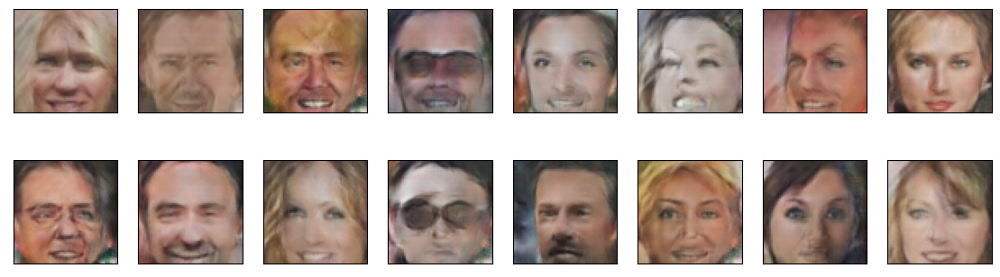

Starting Epoch [42/50]...
2024-11-01 12:15:40 | Epoch [42/50] | Batch 0/509 | d_loss: 0.0060 | g_loss: 8.0864
2024-11-01 12:15:44 | Epoch [42/50] | Batch 50/509 | d_loss: 0.0146 | g_loss: 8.9938
2024-11-01 12:15:49 | Epoch [42/50] | Batch 100/509 | d_loss: 0.0133 | g_loss: 4.4778
2024-11-01 12:15:53 | Epoch [42/50] | Batch 150/509 | d_loss: 0.0244 | g_loss: 4.9777
2024-11-01 12:15:57 | Epoch [42/50] | Batch 200/509 | d_loss: 0.0086 | g_loss: 7.0710
2024-11-01 12:16:02 | Epoch [42/50] | Batch 250/509 | d_loss: 0.0101 | g_loss: 7.3856
2024-11-01 12:16:06 | Epoch [42/50] | Batch 300/509 | d_loss: 0.0091 | g_loss: 6.3405
2024-11-01 12:16:11 | Epoch [42/50] | Batch 350/509 | d_loss: 0.0054 | g_loss: 6.6710
2024-11-01 12:16:15 | Epoch [42/50] | Batch 400/509 | d_loss: 0.0194 | g_loss: 8.5896
2024-11-01 12:16:19 | Epoch [42/50] | Batch 450/509 | d_loss: 0.0020 | g_loss: 8.6488
2024-11-01 12:16:24 | Epoch [42/50] | Batch 500/509 | d_loss: 0.0064 | g_loss: 28.7251
End of Epoch [42/50]. Generati

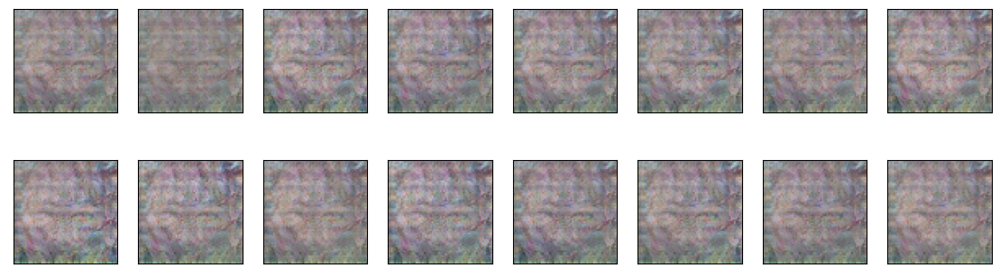

Starting Epoch [43/50]...
2024-11-01 12:16:25 | Epoch [43/50] | Batch 0/509 | d_loss: 0.0010 | g_loss: 21.5220
2024-11-01 12:16:29 | Epoch [43/50] | Batch 50/509 | d_loss: 0.0033 | g_loss: 6.5608
2024-11-01 12:16:34 | Epoch [43/50] | Batch 100/509 | d_loss: 0.0001 | g_loss: 11.6800
2024-11-01 12:16:38 | Epoch [43/50] | Batch 150/509 | d_loss: 0.0006 | g_loss: 9.2643
2024-11-01 12:16:42 | Epoch [43/50] | Batch 200/509 | d_loss: 0.0001 | g_loss: 36.2253
2024-11-01 12:16:47 | Epoch [43/50] | Batch 250/509 | d_loss: 0.0002 | g_loss: 35.7938
2024-11-01 12:16:51 | Epoch [43/50] | Batch 300/509 | d_loss: 0.0002 | g_loss: 35.5482
2024-11-01 12:16:56 | Epoch [43/50] | Batch 350/509 | d_loss: 0.0000 | g_loss: 35.2098
2024-11-01 12:17:00 | Epoch [43/50] | Batch 400/509 | d_loss: 0.0004 | g_loss: 34.8230
2024-11-01 12:17:04 | Epoch [43/50] | Batch 450/509 | d_loss: 0.0002 | g_loss: 33.5260
2024-11-01 12:17:09 | Epoch [43/50] | Batch 500/509 | d_loss: 0.0001 | g_loss: 13.5986
End of Epoch [43/50]. 

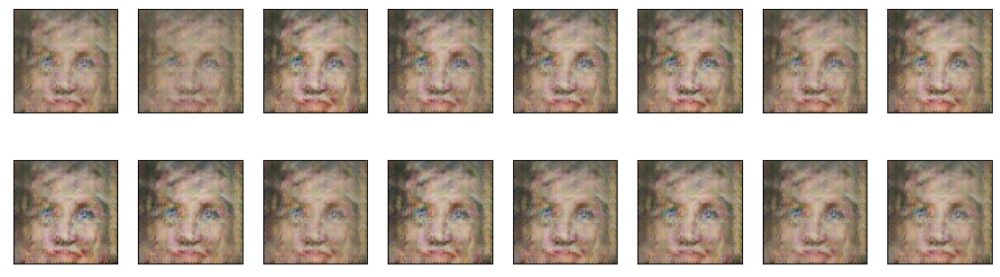

Starting Epoch [44/50]...
2024-11-01 12:17:10 | Epoch [44/50] | Batch 0/509 | d_loss: 0.1456 | g_loss: 22.9337
2024-11-01 12:17:14 | Epoch [44/50] | Batch 50/509 | d_loss: 0.0001 | g_loss: 32.0776
2024-11-01 12:17:18 | Epoch [44/50] | Batch 100/509 | d_loss: 0.0000 | g_loss: 21.5963
2024-11-01 12:17:23 | Epoch [44/50] | Batch 150/509 | d_loss: 0.0265 | g_loss: 7.3925
2024-11-01 12:17:27 | Epoch [44/50] | Batch 200/509 | d_loss: 0.0257 | g_loss: 5.7217
2024-11-01 12:17:31 | Epoch [44/50] | Batch 250/509 | d_loss: 0.0218 | g_loss: 11.7654
2024-11-01 12:17:36 | Epoch [44/50] | Batch 300/509 | d_loss: 0.0015 | g_loss: 8.6829
2024-11-01 12:17:40 | Epoch [44/50] | Batch 350/509 | d_loss: 0.0069 | g_loss: 5.7967
2024-11-01 12:17:45 | Epoch [44/50] | Batch 400/509 | d_loss: 0.0135 | g_loss: 6.4693
2024-11-01 12:17:49 | Epoch [44/50] | Batch 450/509 | d_loss: 0.0002 | g_loss: 14.2101
2024-11-01 12:17:53 | Epoch [44/50] | Batch 500/509 | d_loss: 0.0000 | g_loss: 37.7044
End of Epoch [44/50]. Gen

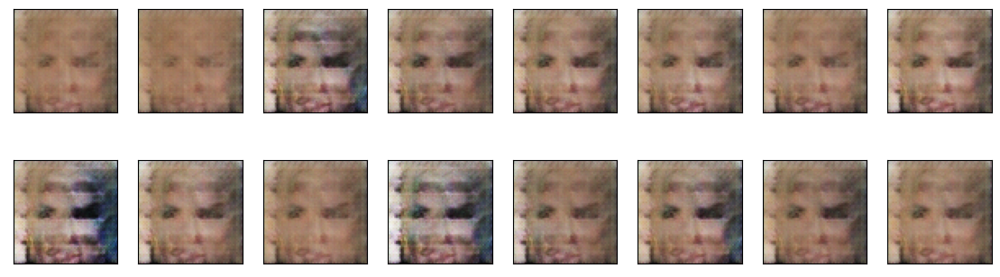

Starting Epoch [45/50]...
2024-11-01 12:17:55 | Epoch [45/50] | Batch 0/509 | d_loss: 0.0000 | g_loss: 37.5656
2024-11-01 12:17:59 | Epoch [45/50] | Batch 50/509 | d_loss: 0.0000 | g_loss: 36.7100
2024-11-01 12:18:03 | Epoch [45/50] | Batch 100/509 | d_loss: 0.0000 | g_loss: 35.6398
2024-11-01 12:18:07 | Epoch [45/50] | Batch 150/509 | d_loss: 0.0000 | g_loss: 35.8133
2024-11-01 12:18:12 | Epoch [45/50] | Batch 200/509 | d_loss: 0.0000 | g_loss: 35.2228
2024-11-01 12:18:16 | Epoch [45/50] | Batch 250/509 | d_loss: 0.0000 | g_loss: 34.5131
2024-11-01 12:18:21 | Epoch [45/50] | Batch 300/509 | d_loss: 0.0003 | g_loss: 15.8902
2024-11-01 12:18:25 | Epoch [45/50] | Batch 350/509 | d_loss: 0.0094 | g_loss: 6.2074
2024-11-01 12:18:30 | Epoch [45/50] | Batch 400/509 | d_loss: 0.0007 | g_loss: 21.0061
2024-11-01 12:18:34 | Epoch [45/50] | Batch 450/509 | d_loss: 0.0114 | g_loss: 9.2092
2024-11-01 12:18:39 | Epoch [45/50] | Batch 500/509 | d_loss: 0.2700 | g_loss: 10.2621
End of Epoch [45/50]. 

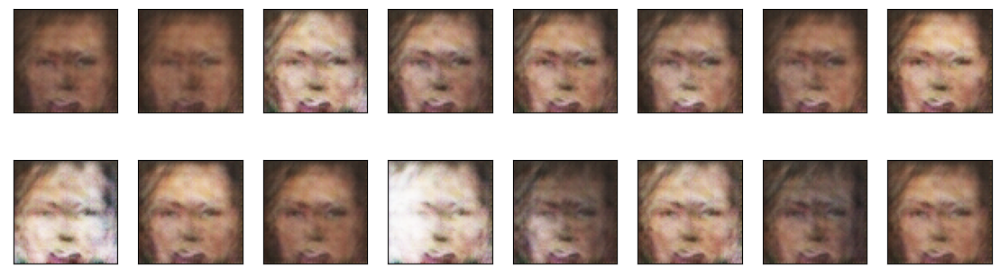

Starting Epoch [46/50]...
2024-11-01 12:18:40 | Epoch [46/50] | Batch 0/509 | d_loss: 0.3056 | g_loss: 11.8431
2024-11-01 12:18:44 | Epoch [46/50] | Batch 50/509 | d_loss: 0.0019 | g_loss: 10.9322
2024-11-01 12:18:49 | Epoch [46/50] | Batch 100/509 | d_loss: 0.0029 | g_loss: 11.7378
2024-11-01 12:18:53 | Epoch [46/50] | Batch 150/509 | d_loss: 0.0219 | g_loss: 13.3672
2024-11-01 12:18:57 | Epoch [46/50] | Batch 200/509 | d_loss: 0.0005 | g_loss: 20.3834
2024-11-01 12:19:02 | Epoch [46/50] | Batch 250/509 | d_loss: 0.0303 | g_loss: 5.6875
2024-11-01 12:19:06 | Epoch [46/50] | Batch 300/509 | d_loss: 0.0202 | g_loss: 5.3092
2024-11-01 12:19:11 | Epoch [46/50] | Batch 350/509 | d_loss: 0.0111 | g_loss: 7.7806
2024-11-01 12:19:15 | Epoch [46/50] | Batch 400/509 | d_loss: 0.0040 | g_loss: 10.0414
2024-11-01 12:19:20 | Epoch [46/50] | Batch 450/509 | d_loss: 0.0011 | g_loss: 11.3726
2024-11-01 12:19:24 | Epoch [46/50] | Batch 500/509 | d_loss: 0.0467 | g_loss: 6.4224
End of Epoch [46/50]. Ge

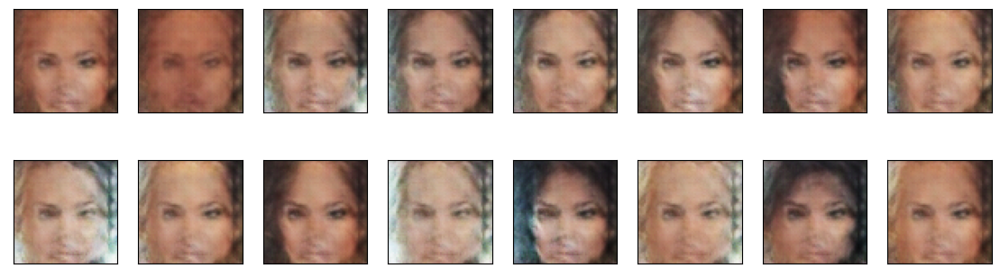

Starting Epoch [47/50]...
2024-11-01 12:19:25 | Epoch [47/50] | Batch 0/509 | d_loss: 0.0015 | g_loss: 17.6223
2024-11-01 12:19:29 | Epoch [47/50] | Batch 50/509 | d_loss: 0.0023 | g_loss: 9.8653
2024-11-01 12:19:34 | Epoch [47/50] | Batch 100/509 | d_loss: 0.0027 | g_loss: 9.2057
2024-11-01 12:19:38 | Epoch [47/50] | Batch 150/509 | d_loss: 0.0025 | g_loss: 10.0720
2024-11-01 12:19:43 | Epoch [47/50] | Batch 200/509 | d_loss: 0.0164 | g_loss: 7.4192
2024-11-01 12:19:47 | Epoch [47/50] | Batch 250/509 | d_loss: 0.0483 | g_loss: 6.7418
2024-11-01 12:19:51 | Epoch [47/50] | Batch 300/509 | d_loss: 0.0196 | g_loss: 5.5128
2024-11-01 12:19:56 | Epoch [47/50] | Batch 350/509 | d_loss: 9.0088 | g_loss: 21.2178
2024-11-01 12:20:00 | Epoch [47/50] | Batch 400/509 | d_loss: 0.0422 | g_loss: 4.3930
2024-11-01 12:20:05 | Epoch [47/50] | Batch 450/509 | d_loss: 0.0119 | g_loss: 5.4912
2024-11-01 12:20:09 | Epoch [47/50] | Batch 500/509 | d_loss: 0.0083 | g_loss: 10.0706
End of Epoch [47/50]. Gener

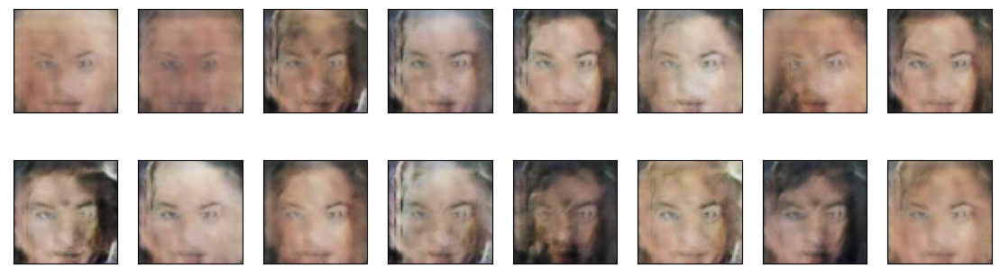

Starting Epoch [48/50]...
2024-11-01 12:20:10 | Epoch [48/50] | Batch 0/509 | d_loss: 0.0018 | g_loss: 14.3419
2024-11-01 12:20:14 | Epoch [48/50] | Batch 50/509 | d_loss: 0.0284 | g_loss: 6.8695
2024-11-01 12:20:19 | Epoch [48/50] | Batch 100/509 | d_loss: 0.0150 | g_loss: 4.8454
2024-11-01 12:20:23 | Epoch [48/50] | Batch 150/509 | d_loss: 0.0222 | g_loss: 5.2054
2024-11-01 12:20:28 | Epoch [48/50] | Batch 200/509 | d_loss: 0.0084 | g_loss: 8.3567
2024-11-01 12:20:32 | Epoch [48/50] | Batch 250/509 | d_loss: 0.0179 | g_loss: 9.6502
2024-11-01 12:20:36 | Epoch [48/50] | Batch 300/509 | d_loss: 0.5728 | g_loss: 16.7809
2024-11-01 12:20:41 | Epoch [48/50] | Batch 350/509 | d_loss: 0.0072 | g_loss: 10.3256
2024-11-01 12:20:45 | Epoch [48/50] | Batch 400/509 | d_loss: 0.0011 | g_loss: 9.1420
2024-11-01 12:20:50 | Epoch [48/50] | Batch 450/509 | d_loss: 0.0006 | g_loss: 11.1164
2024-11-01 12:20:54 | Epoch [48/50] | Batch 500/509 | d_loss: 0.0075 | g_loss: 9.2214
End of Epoch [48/50]. Gener

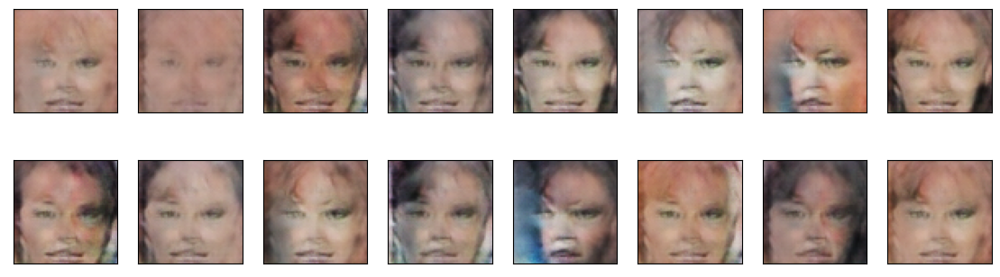

Starting Epoch [49/50]...
2024-11-01 12:20:55 | Epoch [49/50] | Batch 0/509 | d_loss: 0.0521 | g_loss: 5.4584
2024-11-01 12:21:00 | Epoch [49/50] | Batch 50/509 | d_loss: 0.0104 | g_loss: 6.3148
2024-11-01 12:21:04 | Epoch [49/50] | Batch 100/509 | d_loss: 0.0051 | g_loss: 6.9472
2024-11-01 12:21:09 | Epoch [49/50] | Batch 150/509 | d_loss: 0.0006 | g_loss: 10.4443
2024-11-01 12:21:13 | Epoch [49/50] | Batch 200/509 | d_loss: 0.0264 | g_loss: 5.6185
2024-11-01 12:21:17 | Epoch [49/50] | Batch 250/509 | d_loss: 0.0093 | g_loss: 6.2603
2024-11-01 12:21:22 | Epoch [49/50] | Batch 300/509 | d_loss: 0.0276 | g_loss: 5.9829
2024-11-01 12:21:26 | Epoch [49/50] | Batch 350/509 | d_loss: 0.0586 | g_loss: 7.2687
2024-11-01 12:21:30 | Epoch [49/50] | Batch 400/509 | d_loss: 0.0233 | g_loss: 7.4110
2024-11-01 12:21:35 | Epoch [49/50] | Batch 450/509 | d_loss: 0.0348 | g_loss: 5.8948
2024-11-01 12:21:39 | Epoch [49/50] | Batch 500/509 | d_loss: 0.0107 | g_loss: 6.6800
End of Epoch [49/50]. Generati

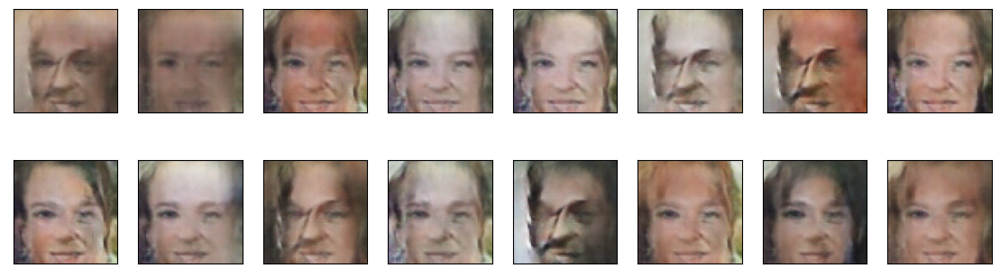

Starting Epoch [50/50]...
2024-11-01 12:21:40 | Epoch [50/50] | Batch 0/509 | d_loss: 0.0005 | g_loss: 12.9410
2024-11-01 12:21:44 | Epoch [50/50] | Batch 50/509 | d_loss: 0.0310 | g_loss: 5.8268
2024-11-01 12:21:49 | Epoch [50/50] | Batch 100/509 | d_loss: 0.0537 | g_loss: 8.5252
2024-11-01 12:21:53 | Epoch [50/50] | Batch 150/509 | d_loss: 0.0083 | g_loss: 11.5619
2024-11-01 12:21:58 | Epoch [50/50] | Batch 200/509 | d_loss: 0.0077 | g_loss: 7.7088
2024-11-01 12:22:02 | Epoch [50/50] | Batch 250/509 | d_loss: 0.0057 | g_loss: 7.4509
2024-11-01 12:22:07 | Epoch [50/50] | Batch 300/509 | d_loss: 0.1377 | g_loss: 8.7032
2024-11-01 12:22:11 | Epoch [50/50] | Batch 350/509 | d_loss: 0.0533 | g_loss: 7.6555
2024-11-01 12:22:16 | Epoch [50/50] | Batch 400/509 | d_loss: 0.0153 | g_loss: 9.7080
2024-11-01 12:22:20 | Epoch [50/50] | Batch 450/509 | d_loss: 0.0252 | g_loss: 6.0601
2024-11-01 12:22:24 | Epoch [50/50] | Batch 500/509 | d_loss: 0.0140 | g_loss: 8.8431
End of Epoch [50/50]. Generat

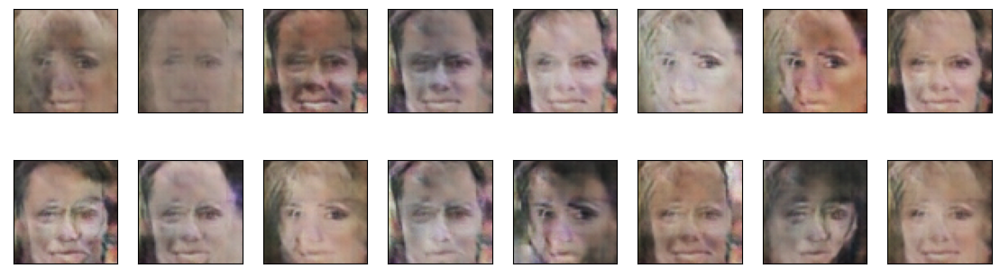

Training complete.


In [30]:
# fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).float().cuda()

# losses = []
# for epoch in range(n_epochs):
#     for batch_i, real_images in enumerate(dataloader):
#         real_images = real_images.to(device)
        
#         ####################################
        
#         # TODO: implement the training strategy
        
#         ####################################
        
#         if batch_i % print_every == 0:
#             # append discriminator loss and generator loss
#             d = d_loss['loss'].item()
#             g = g_loss['loss'].item()
#             losses.append((d, g))
#             # print discriminator and generator loss
#             time = str(datetime.now()).split('.')[0]
#             print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
#     # display images during training
#     generator.eval()
#     generated_images = generator(fixed_latent_vector)
#     display(generated_images)
#     generator.train()


# ––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––
# from datetime import datetime
# 
# # Fixed latent vector for visualizing generator's progress
# fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).to(device)
# 
# losses = []
# for epoch in range(n_epochs):
#     for batch_i, real_images in enumerate(dataloader):
#         real_images = real_images.to(device)
# 
#         ####################################
#         # Train the discriminator
#         d_loss = discriminator_step(
#             generator, discriminator, d_optimizer, 
#             batch_size, latent_dim, real_images, device
#         )
# 
#         # Train the generator twice for better convergence
#         g_loss = generator_step(
#             generator, discriminator, g_optimizer, 
#             batch_size, latent_dim, device
#         )
#         # g_loss = generator_step(
#         #     generator, discriminator, g_optimizer, 
#         #     batch_size, latent_dim, device
#         # )
#         ####################################
# 
#         if batch_i % print_every == 0:
#             # Append discriminator and generator losses
#             d = d_loss['loss'].item()
#             g = g_loss['loss'].item()
#             losses.append((d, g))
# 
#             # Print loss details
#             time = str(datetime.now()).split('.')[0]
#             print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
# 
#     # Display images during training
#     generator.eval()
#     generated_images = generator(fixed_latent_vector)
#     display(generated_images)
#     generator.train()


from datetime import datetime

# Fixed latent vector for visualizing generator's progress
fixed_latent_vector = torch.randn(16, latent_dim, 1, 1).to(device)

losses = []
for epoch in range(n_epochs):
    print(f"Starting Epoch [{epoch+1}/{n_epochs}]...")  # Start of each epoch
    
    for batch_i, real_images in enumerate(dataloader):
        real_images = real_images.to(device)

        ####################################
        # Train the discriminator
        d_loss = discriminator_step(
            generator, discriminator, d_optimizer, 
            batch_size, latent_dim, real_images, device
        )

        # Train the generator twice for better convergence
        g_loss = generator_step(
            generator, discriminator, g_optimizer, 
            batch_size, latent_dim, device
        )
        # Uncomment if you need a second generator step
        # g_loss = generator_step(
        #     generator, discriminator, g_optimizer, 
        #     batch_size, latent_dim, device
        # )
        ####################################

        if batch_i % print_every == 0:
            # Append discriminator and generator losses
            d = d_loss['loss'].item()
            g = g_loss['loss'].item()
            losses.append((d, g))

            # Print loss details
            time = str(datetime.now()).split('.')[0]
            print(f'{time} | Epoch [{epoch+1}/{n_epochs}] | Batch {batch_i}/{len(dataloader)} | d_loss: {d:.4f} | g_loss: {g:.4f}')
    
    # Display images during training
    print(f"End of Epoch [{epoch+1}/{n_epochs}]. Generating sample images...")
    generator.eval()
    generated_images = generator(fixed_latent_vector)
    display(generated_images)
    generator.train()

print("Training complete.")



        


### Training losses

Plot the training losses for the generator and discriminator.

In [ ]:
%matplotlib inline

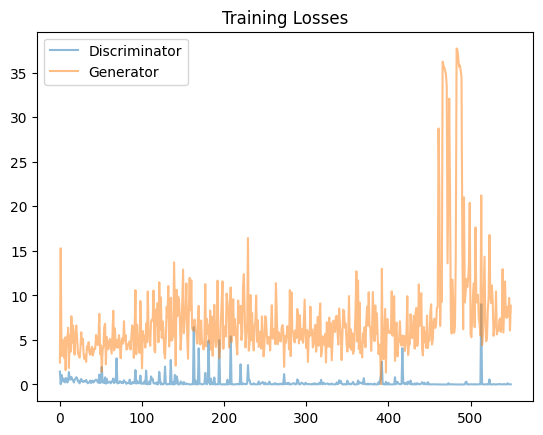

In [31]:
"""
DO NOT MODIFY ANYTHING IN THIS CELL
"""
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

### Question: What do you notice about your generated samples and how might you improve this model?
When you answer this question, consider the following factors:
* The dataset is biased; it is made of "celebrity" faces that are mostly white
* Model size; larger models have the opportunity to learn more features in a data feature space
* Optimization strategy; optimizers and number of epochs affect your final result
* Loss functions

**Answer:** (Write your answer in this cell)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb".  

Submit the notebook using the ***SUBMIT*** button in the bottom right corner of the Project Workspace.